## API Driven Development

An API is an interface. An interface has defined actions, defined inputs, and defined outputs.

Interfaces allow you flexibility when it comes to programming. You can define how you want your clients or consumers to interact with your service. You define the actions, inputs, and outputs. From there, you can implement it however you want behind the scenes, and as long as you are fulfilling your end of the bargain and the outputs are what they should be given the input, no one using the interface needs to know or care about the implementation.

One way we use APIs is to expose services to one another. If I have a program that is composed of five different microservices,
they would all communicate via a technology-agnostic communication protocol. Like using RESTful HTTP-based calls, where as long as the service can speak HTTP, it doesn't matter what each service is implemented in. 
Maybe one service is best written in Python, but another service is best written in Java. Doesn't matter because you are enforcing the use of interfaces through your APIs. 
When the API doesn't change, everything works nicely. 

Once your APIs are defined and shared with clients, it's important that you do what you can to maintain backwards compatibility with changes. The more changes to your API, the more the consumers using your API will need to change as well. This is why it is so important to make sure you are spending time designing your APIs up front and exploring what the actions, inputs, and outputs should be. Because once they are written, you shouldn't make large sweeping changes to them unless necessary. To do it right, you have to really know what you are trying to build and the way it behaves.

Following the practice of designing the API first is called API-driven development, where the first artifact created out of
building a new service is the API. Once the API is created, the front-end, or clients, using the API and the actual implementation of the API can be built in parallel.
At the end, when both pieces are done, they should be able to communicate seamlessly as long as the back-end implementation
adhere to the API that was first designed and it didn't get changed. That is one of the benefits of API-driven development, or API-driven design. 

You can speed up application development as the front-end and back-end can be built in tandem. Another benefit is that by building your app with APIs, you are inherently building a modular app, like service-oriented architectures or microservice architectures, as each API clearly defines the bounds and scope of the program.

Finally, one of the great benefits of building your apps with APIs is that it aids in documentation. Most people don't like documenting their code, but it's important if you want that code to be useful to others, not only today, but also in the future.
There are even tools out there that automatically update documentation as APIs change over time. 

<pre>

    
</pre>
### What is API Gateway?


The specific tool we're going to introduce here is Amazon API Gateway.
API Gateway is an AWS service for creating, publishing, maintaining, monitoring, and securing REST, HTTP, and WebSocket APIs at any scale and app developers can create APIs that access AWS or other web services as well as data stored in the AWS Cloud.

WebSocket APIs operate using lower-level protocols based on sockets and ports and requires the use of IP addresses and port information. It is bidirectional, stateful, vertically scalable, and is ideally used for real-time scenarios such as a chat application as part of a game.

HTTP APIs enable you to create RESTful APIs with lower latency and lower costs than REST APIs. You can use these to send requests to AWS Lambda functions or to any route-able HTTP endpoint. This could be used when creating an HTTP API that integrates with a Lambda function on the backend. 

When the client calls the API, API Gateway sends the request to the Lambda function and returns the functions response to the client.

Where we'll be focusing is in REST APIs, which are fast, stateless, standard, horizontally scalable and dependable.

Other features provided by API Gateway are Canary release deployments for safety, rolling out changes, logging and monitoring through AWS CloudTrail and Amazon CloudWatch, support for custom domain names, throttling of requests, and direct integration with other AWS services including AWS WAF, AWS X-Ray and AWS Lambda. 

The notes will have links to the documentation
for you to explore further,
so make sure you check those out.
As far as concepts go,
a major one for me to mention is methods.

A method represents a client-facing interface by which the client calls the API to access backend resources and refers to the particular HTTP verb used with a request. An API method uses a method request and a method response, and is set up to define what a client should or must do to submit a request to access the service at the backend as well as define the responses
that the client receives in return.

For example, if you wanted your clients to send data to be ingested by an Amazon simple notification topic, specifically using a post method, you could specify that the accepted HTTP method type be post for your method request.

The other concept I want to talk about here is that API Gateway provides multiple endpoint types that you can utilize.
An API endpoint type refers to the host name of the API. It can be edge optimized, regional or private depending on where the majority of your API traffic originates.

Edge optimized API endpoints are best for geographically distributed clients. Requests are routed to the nearest Amazon CloudFront point of presence. This is the default type for API Gateway REST APIs. 

A regional API endpoint is intended for clients in the same region. When a client running an Amazon EC2 instance calls an API in the same region or when an API is intended to serve a small number of clients with high demands, a regional API endpoint reduces connection overhead.

Lastly, private API endpoints are a great way to provide a client secure access to resources inside of an Amazon virtual private cloud. Private APIs are isolated from the public internet and they are only accessed using VPC endpoints
for API Gateway that have been granted access.


<pre>


    
</pre>
### Dragon API: API Gateway Terminology


We're going to build the first method of our dragon API.

To start, we'll be going through the console and exploring some of the different pieces you can configure, as well as what they mean.

First things first, let's navigate to the API Gateway service. And then from here, we are going to create our new API. Notice right away, there are multiple options.

You can build an HTTP API. This is designed to offer REST base HTTP API's at low latency and low cost. HTTP API's are used to proxy backend resources and are supposed to be simple and fast. This is great for when you want API Gateway to simply take in a request, authorize it and pass it on to the backend resource like a Lambda function or an HTTP endpoint.

Next is a WebSocket API. WebSockets unlike HTTP, is a stateful communications protocol. WebSocket API's allow for support for applications that need real time data or real time communication. 

API Gateway also supports REST API's. REST API's with API Gateway uses HTTPS and is stateless. This is very similar to HTTP API's, but it offers some different functionality. REST API's allow you to have full control over the response and requests
between your client and API Gateway. You can apply what are called models and mappings to validate and transform requests and responses.

The last option here is a private REST API. This is the same thing as a normal REST API, but it allows to set up an API
that can only be accessed from a VPC, creating a private API. This is useful for internal APIs that you do not want to expose to outside clients. 

We're going to select the public REST API, because we have some use cases that require we validate and transform incoming requests before they reach the backend.
You could import or build your own API from scratch, we are going to select Build. 

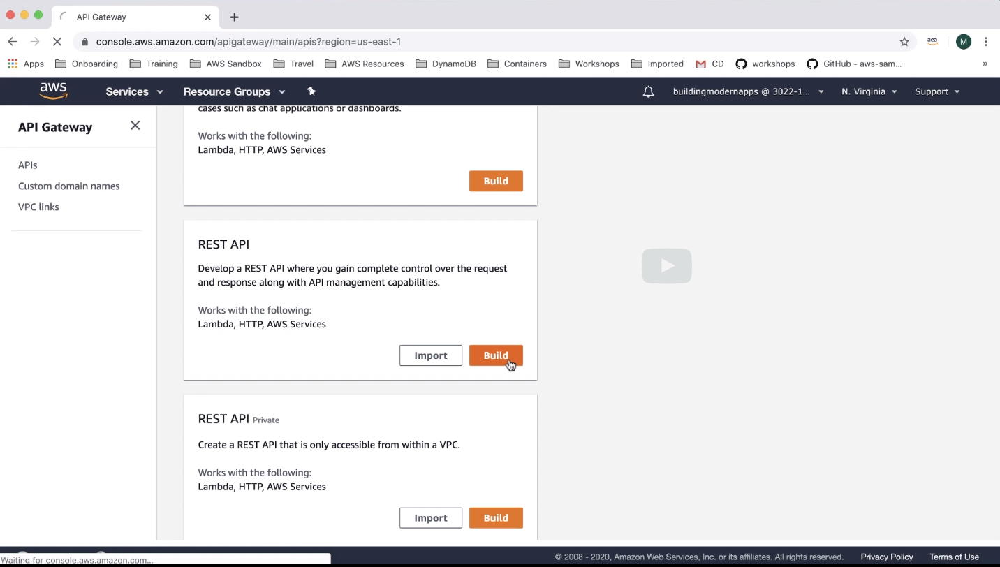

I'm going to go ahead and click OK here. I'm going to leave REST as the type of API. And then I'm going to select a new API here, though you also could import from Swagger
or an open API document or you could select an example API, we're going to go ahead and select New. 
And the name of this API is dragons. And we're going to leave the rest of the defaults there and just click Create API.

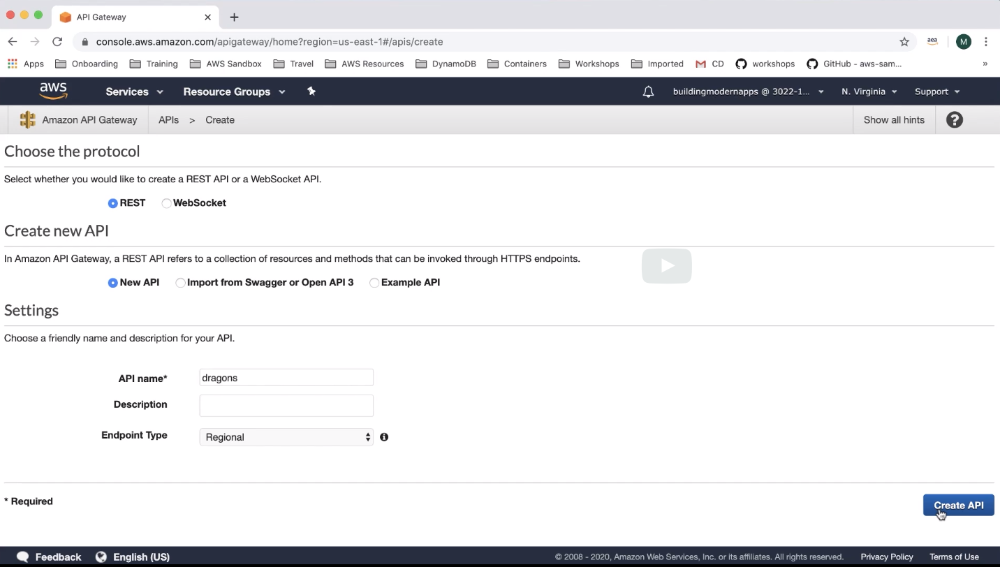

This brings me to the next screen where I can then begin to build out my API. On the left hand side here is the Navigation,
for everything you can configure for an API. We're going to talk about most of these things before the class is over.
For now though, we're just going to keep it simple.
I want to create an API that allows me to submit a request and responds with a 200 OK but doesn't actually hit any real backend. To do that, I need to first create a resource. So I'll go ahead and click Actions/Create Resource.

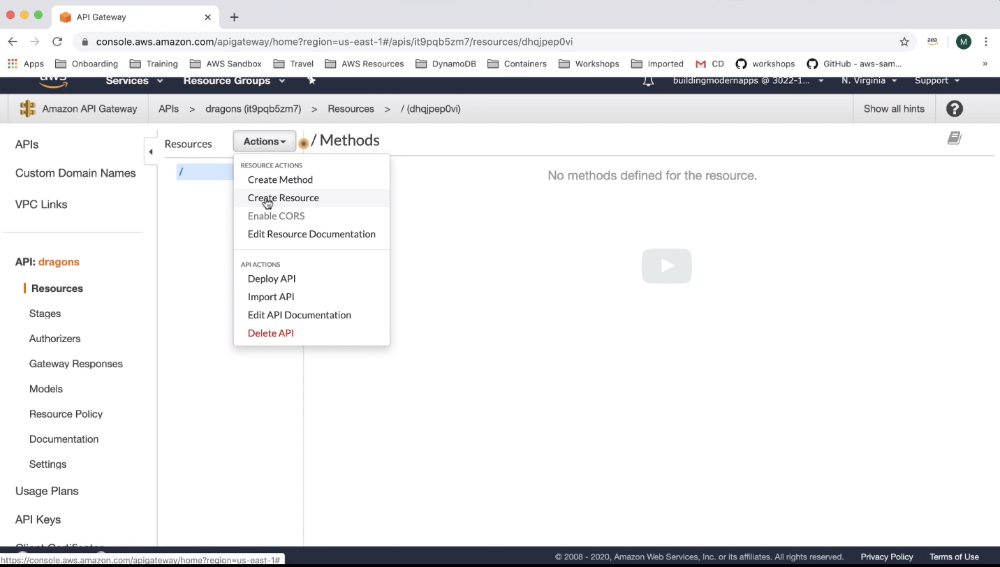

A resource is an abstract concept that allows you to expose a thing to be consumed by a client. 
For our example, we will be building out the dragons API. So the resource is the dragon data. So I'm going to go ahead and add my resource name, dragons. And I'm also going to opt to enable CORS on the resource. And this will enable cross origin
resource sharing for this API, and this will be used for future use. Click Create Resource 

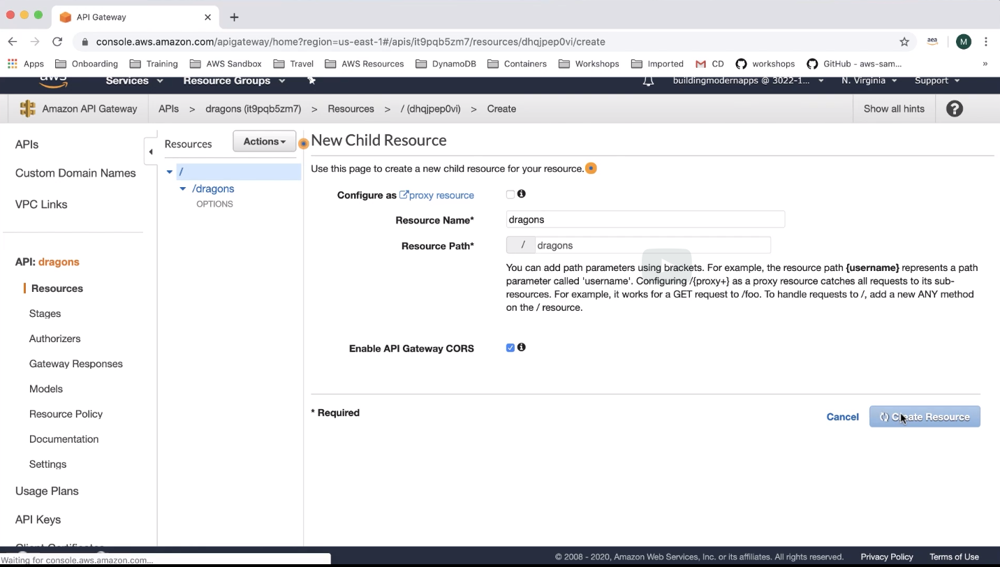

and now we have a resource dragons'.

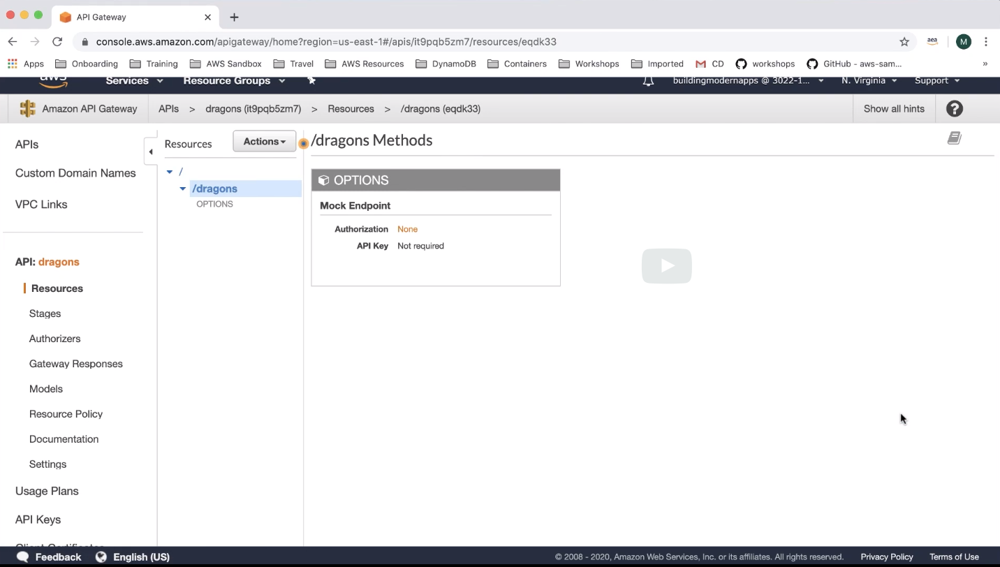


Resources in API's have methods that allow you to interact or submit actions to a resource.
In our dragon example, we will be using HTTP methods like GET, POST, PUT and delete.
We will only be using GET or POST in our dragon example. But you can use whatever HTTP methods you like in your own APIs. So now let's go ahead and create a method. 
So I will click Actions, Create Method.

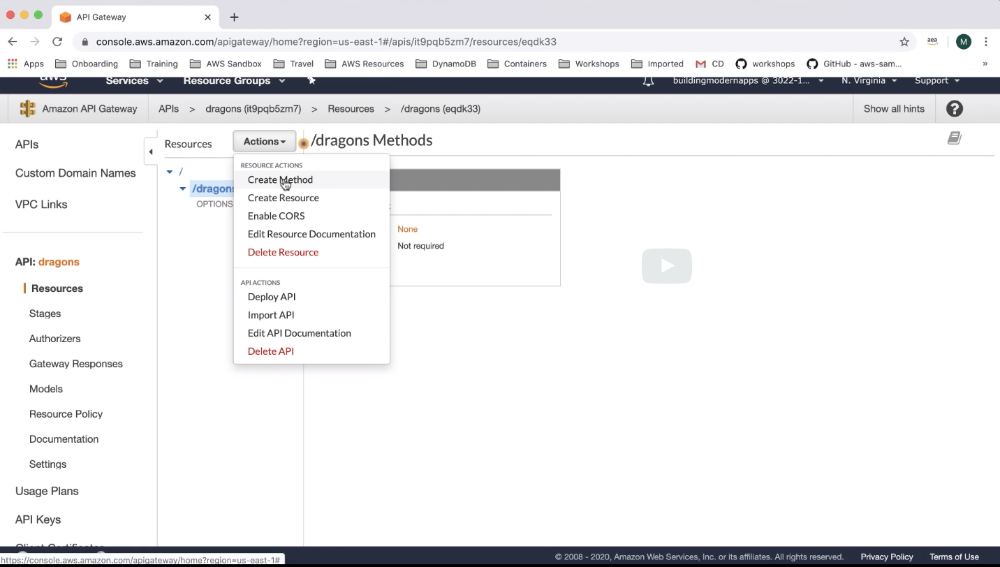

And we're going to select the GET method here, 

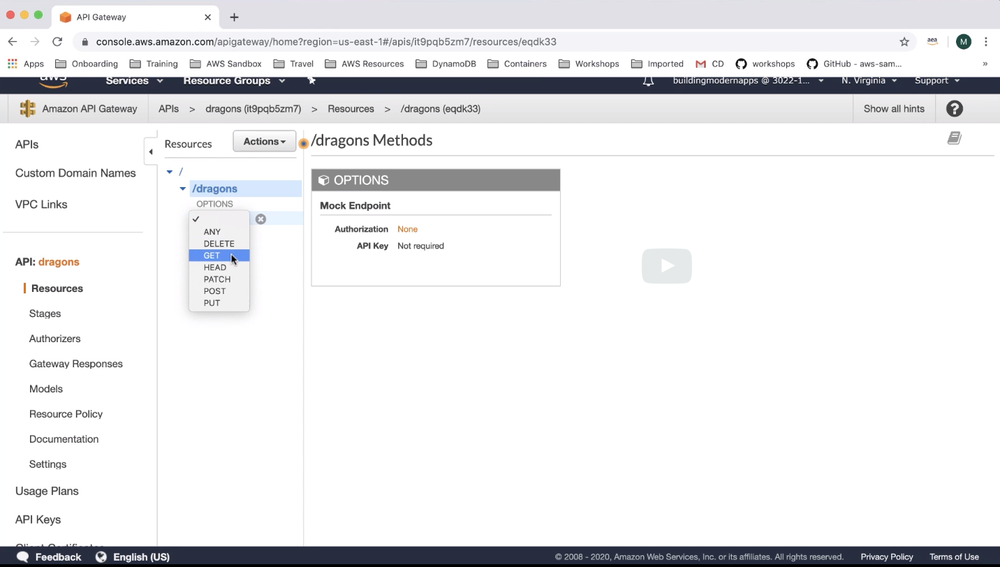

and then click the check mark.

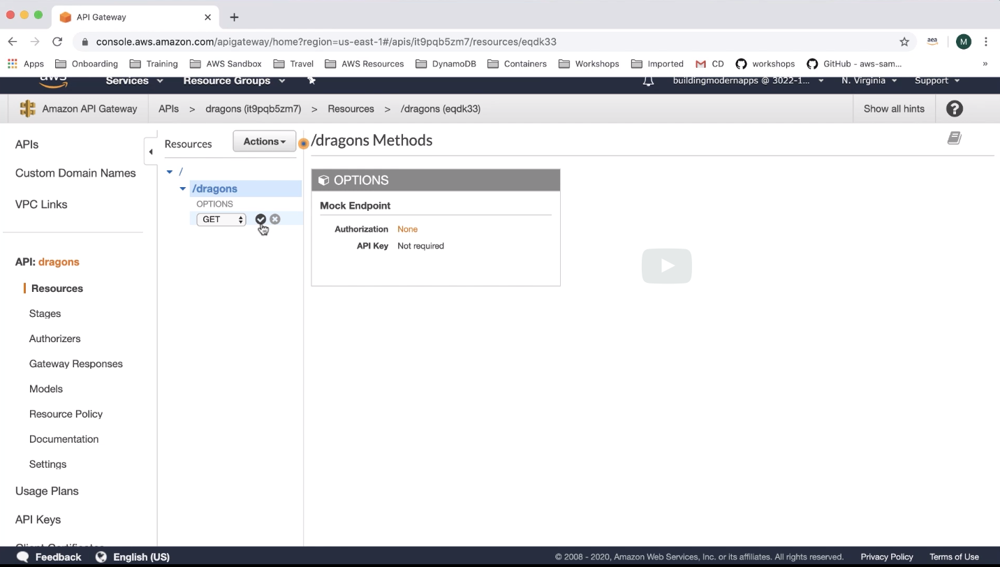

This brings up a screen for us to configure the integration type. This is where you select what you want your API to sit in front of, and how you want your API to integrate with that backend. You can select a Lambda function where API Gateway is purely a proxy for that Lambda function, HTTP --where you can paste an endpoint that already exists and you want API Gateway to front that. Mock -- where you don't front anything real and instead, you just stub out the API, or a AWS service where you can select another AWS service for API Gateway to front, which we will go into detail on this later in the course. Or you can select a VPC link, which allows you to expose resources inside of a VPC. We're following an API driven development process
and want to design and build the API first. So we will select Mock as the integration type and then I'm going to go ahead and click Save. 

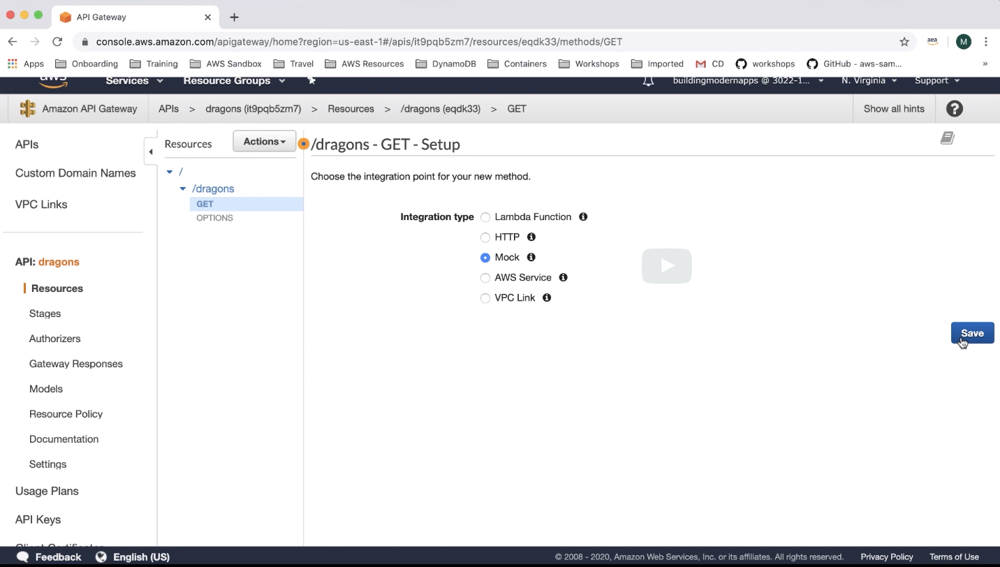

The Mock integration type allows you to set up the API and interact with it without ever needing to actually hit another service for the backend. You can hardcode the responses you expect and test it before building and integrating
with a real backend. So we're isolating this front end, this API to our backend service. So we need to get this right
before we can build the backend out. Now we are brought to this screen, which shows the flow of the request and the response with API Gateway. 

You have the method request here first, which is the first step for API Gateway to accept a request.

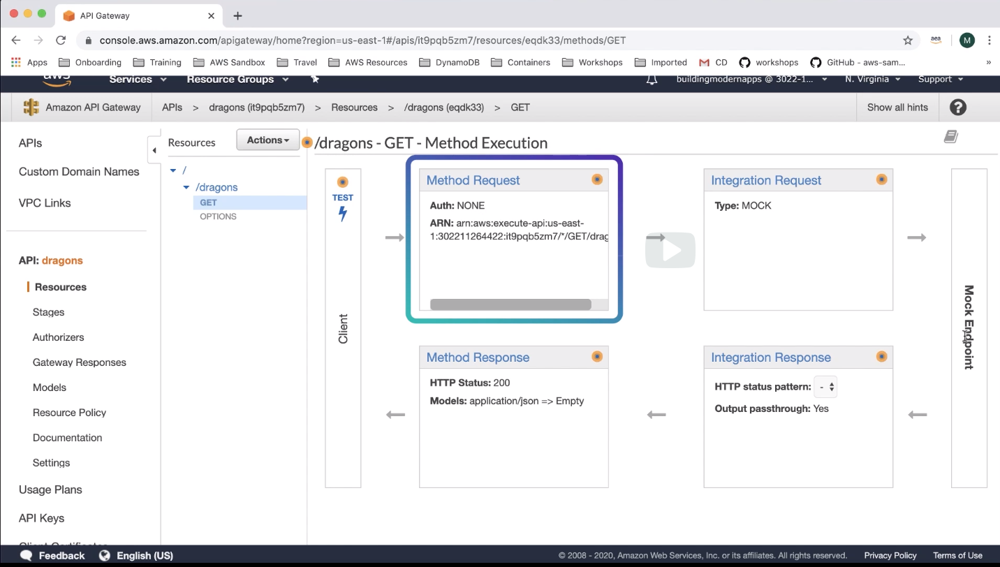

This is where you can apply authorization and data payload validation. 
Next, it is passed to the integration request. 

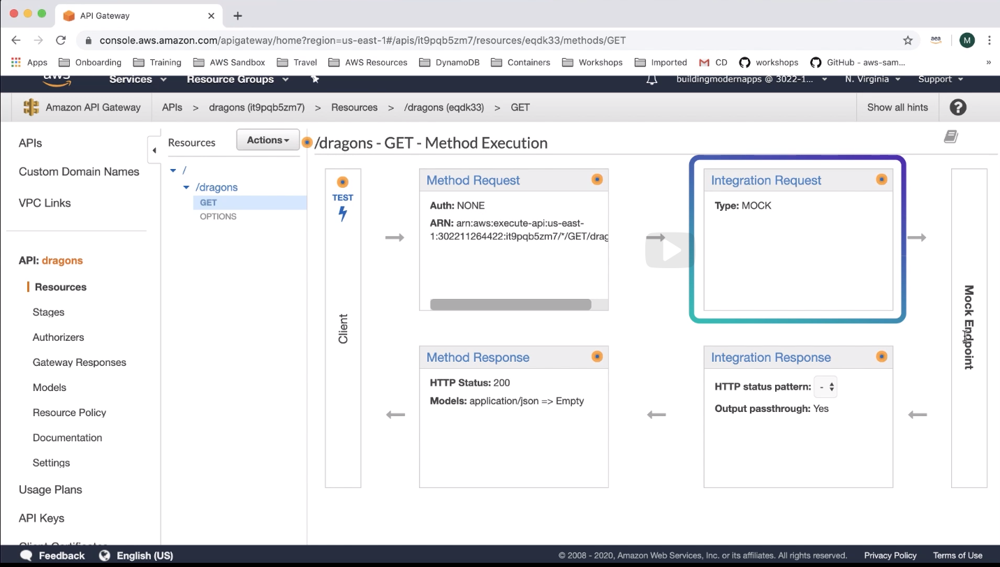

This is where you configure what backend service you are fronting with API Gateway, as well as applying any sort of data transformations that you may require. Again in our case, this is a mock.

Once the request has passed the validation and the authorization and the transformation steps, it will then send the request to the backend service. In our case, since this is a mock endpoint, it will take the request, do nothing and then send a response.
Then down on the bottom of the screen on the way out for the response, it will hit the integration response. 

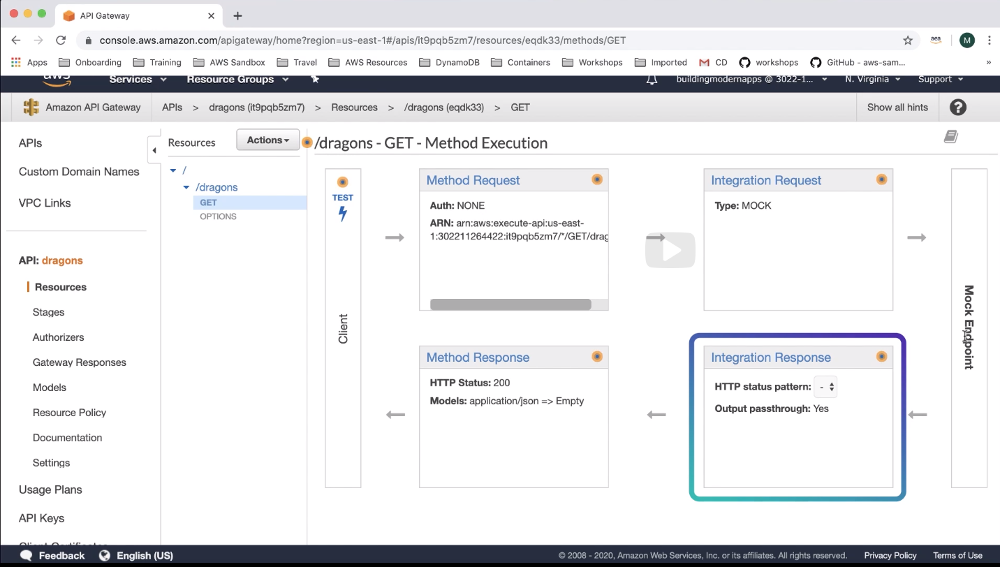

And integration response is an HTTP response encapsulating the backend response. 
You can configure how your backend service responses map to HTTP responses and apply data transformations at this step as well.

And finally, there is the method response.

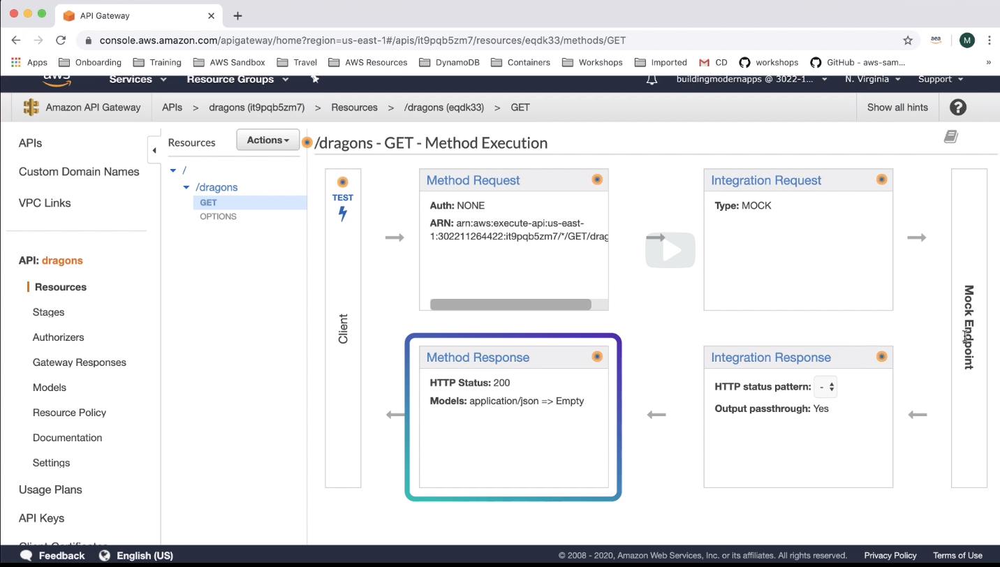

Method responses are similar to method requests. They're responsible for validating and fitting responses to models. The only real difference is that they are applying this data validation to the response, not to the client. 

You can test your API right here in the console, you can see the test button right here. And since we aren't applying any sort of data validation or transformation yet, we can actually go ahead and just click on the test. And that brings us to this method test page.

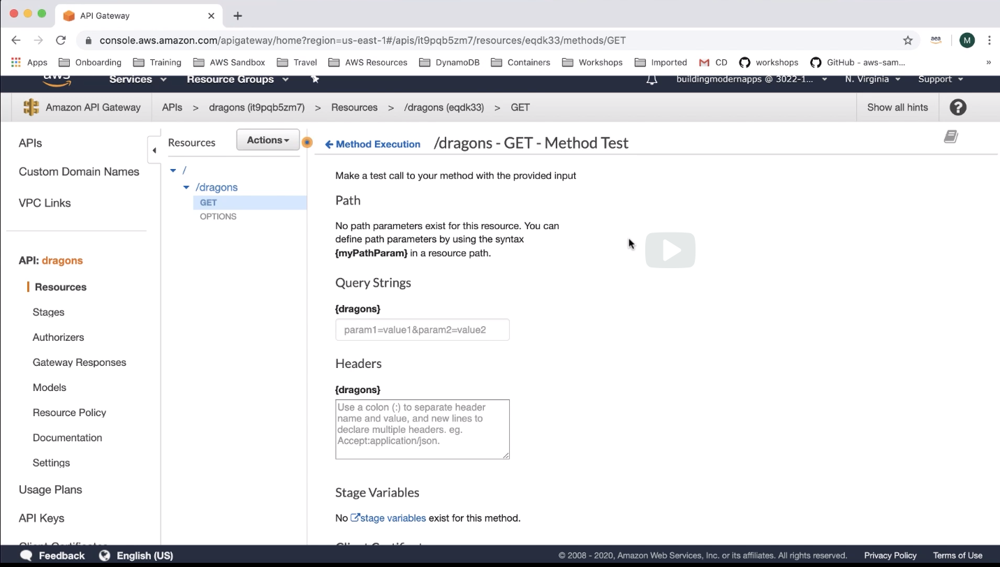

So here, if I leave everything blank and I scroll down, you can see there's a place where you can put your query strings, your query string parameters, you can add headers, we're going to leave all of this blank. I'm just going to go ahead and click test.

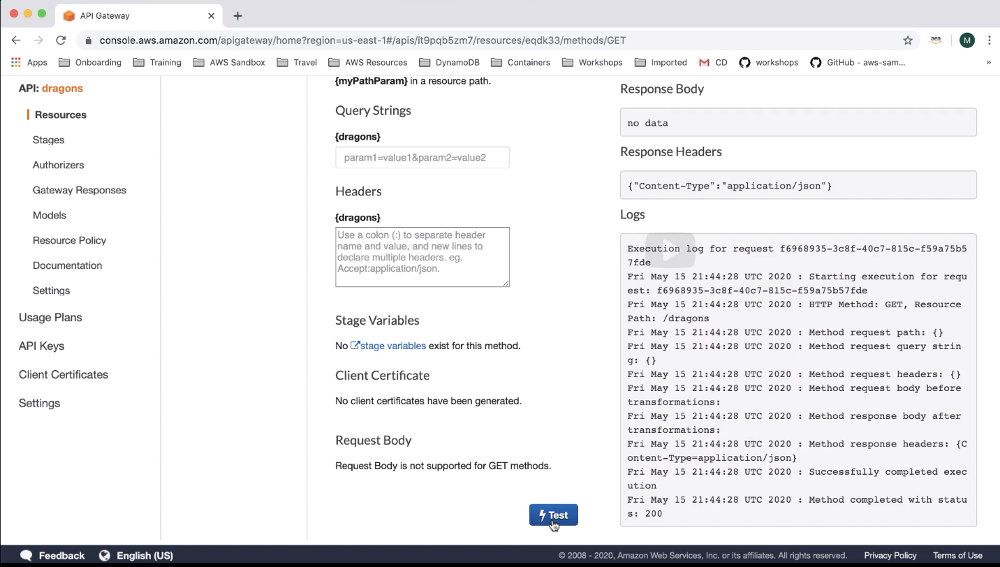

And for us, since we are really just setting up scaffolding, there's nothing real to test as you can see, over on the right hand side, it's giving us a log of everything that happened with this API.
So first, we submitted a GET request to the resource dragons. And then it passed through the method request path, a checked the query string parameters, the headers, the bodies, and then from there, it's sent it to the backend, which is nothing because it's a Mock. And then we have the method response coming back through checking through for any headers, and then we can see it successfully completed the execution with a status code of 200.

<pre>


    
</pre>


### What is API Gateway Notes, API Driven Dev Notes

### <ins>API Driven Development</ins>

#### What is API Driven Development?

API Driven Development is a process that allows developers to focus on API design before writing code. The idea is, before you start writing your software, you first design and agree on what the API will be. You focus time up front putting thoughtful design into this API, and the first artifact out of the process is the API design. This API design could be captured in a document, or it could be built out as a Mock API.

Creating the API before you create the code that backs the API provides benefits to both the developers creating the backend code, as well as the clients who will be consuming the API.

#### Faster Application Development

Both the backend API Code and Client code can be written in parallel once the API design is created. Integrating and merging the two also becomes easier as the API is the contract upon which they both agreed. If the contract didn't change, the release of the actual backend code should go smoothly.

#### APIs encourage modular architectures

By designing the API up front, you know what functionality should exist in the code and therefore the scope of the program is well defined. This encourages modular and distributed architectures.

#### Uncover API Incompatibilities quickly

By designing and releasing the API first, you are allowing the consumers of the API to discover incompatible integrations quickly, instead of having integration be the last step for release.

#### Your App will be ready to connect to the world

Through hosting your code with an API, you can then integrate it with other systems easily.

#### Documentation

By following API Driven Development you have already documented the API and its features before you implement it. Tools exist in the market that allow you to visualize your API.

To read about Microservices and API Gateway on AWS click here: 
https://docs.aws.amazon.com/whitepapers/latest/microservices-on-aws/api-implementation.html

To read about API Management in general on AWS click here: 
https://aws.amazon.com/api-gateway/api-management/

### <ins>Amazon API Gateway</ins>

#### What is Amazon API Gateway?

Amazon API Gateway is an AWS service for creating, publishing, maintaining, monitoring, and securing REST, HTTP, and WebSocket APIs at any scale. API developers can create APIs that access AWS or other web services, as well as data stored in the AWS Cloud. As an API Gateway API developer, you can create APIs for use in your own client applications. Or you can make your APIs available to third-party app developers.

API Gateway creates RESTful APIs that:

* Are HTTP-based.

* Enable stateless client-server communication.

* Implement standard HTTP methods such as GET, POST, PUT, PATCH, and DELETE.

Read more about Amazon API Gateway at: 
https://docs.aws.amazon.com/apigateway/latest/developerguide/welcome.html

### <ins>API Gateway REST APIs</ins>

API Gateway supports multiple types of APIs, in this course we will be focusing on REST APIs.

A REST API in API Gateway is a collection of resources and methods that are integrated with backend HTTP endpoints, Lambda functions, or other AWS services. You can use API Gateway features to help you with all aspects of the API lifecycle, from creation through monitoring your production APIs.

API Gateway REST APIs use a request/response model where a client sends a request to a service and the service responds back synchronously. This kind of model is suitable for many different kinds of applications that depend on synchronous communication.

API Gateway REST APIs have multiple configurable pieces:
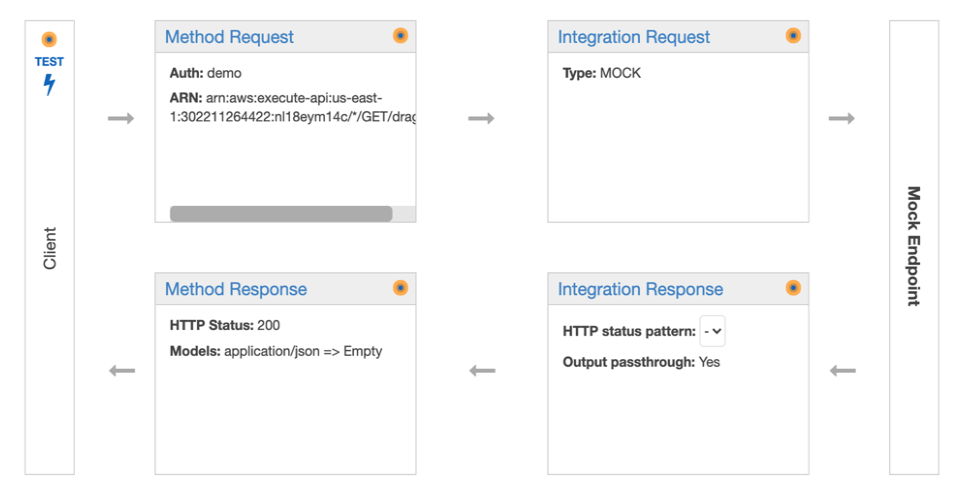


The diagram above shows what steps a client call makes to the API to access backend resources. A Method resource is integrated with an Integration resource. Both consist of a request and one or more responses. The method request takes the client input, and optionally validates it if configured - either against JSON Schema models or it checks the required request parameters in the URI, query string, and headers of an incoming request are included and non-blank.

If the validation fails, API Gateway immediately fails the request, returns a 400 error response to the caller, and publishes the validation results in CloudWatch Logs. This reduces unnecessary calls to the backend.

Then, the client input is passed to the back end through the integration request. The integration request is where you configure what backend resource the API will be passing the client input to. This is also where you perform any mappings or data transformations potentially using VTL Mappings.

The request then gets passed to the backend resource.

A method response returns the output from the backend to the client through an integration response. You can configure data mappings on the response from the backend at the integration request level. An integration response is an HTTP response encapsulating the backend response. You can map backend responses to specific HTTP codes.

A method request is embodied in a Method resource, whereas an integration request is embodied in an Integration resource. On the other hand, a method response is represented by a MethodResponse resource, whereas an integration response is represented by an IntegrationResponse resource.

Read more about Developing REST APIs with API Gateway at: 
https://docs.aws.amazon.com/apigateway/latest/developerguide/rest-api-develop.html

### Models and Mapping


API Gateway has a lot of great features that allow you to offload some of the burden that might otherwise be on your back end services. For example, it's oftentimes the back end service that is checking the incoming payload for required fields, ensuring data is not null, or checking that the data is formatted in a particular way, in order for the code to run properly.  
  
API Gateway REST APIs provide a way to validate incoming requests against models, and data can be transformed in shape by using API Gateway mappings.  
  
API Gateway supports multiple types of APIs, like HTTP APIs and WebSockets.  
  
For this video, we're focusing on the functionality that comes with REST APIs.  
  
Oftentimes, you will be using API Gateway as just a proxy for your back end, and you won't need to do any data validation or transformation at all. You could easily use API Gateway HTTP APIs for that use case.  
But just know that if you do need data validation and transformation down at the API Gateway level, you can do that with models and mappings and REST APIs.  
  
All right, let's start with models.  
Models in API Gateway define the structure or shape of the payload of the request.  
Models are created using JSON schemas, which allow you to define the properties of the payload and their types.  
When a request comes in, it will be validated against that schema. And if API Gateway sees that the data cannot be fit into the JSON schema, then API Gateway will return a 400-error response code to the client. This frees up your back end from having to do the sort of basic data validation.  
  
Let's take a look at an example. This is what a JSON payload for reporting a new dragon would look like.  
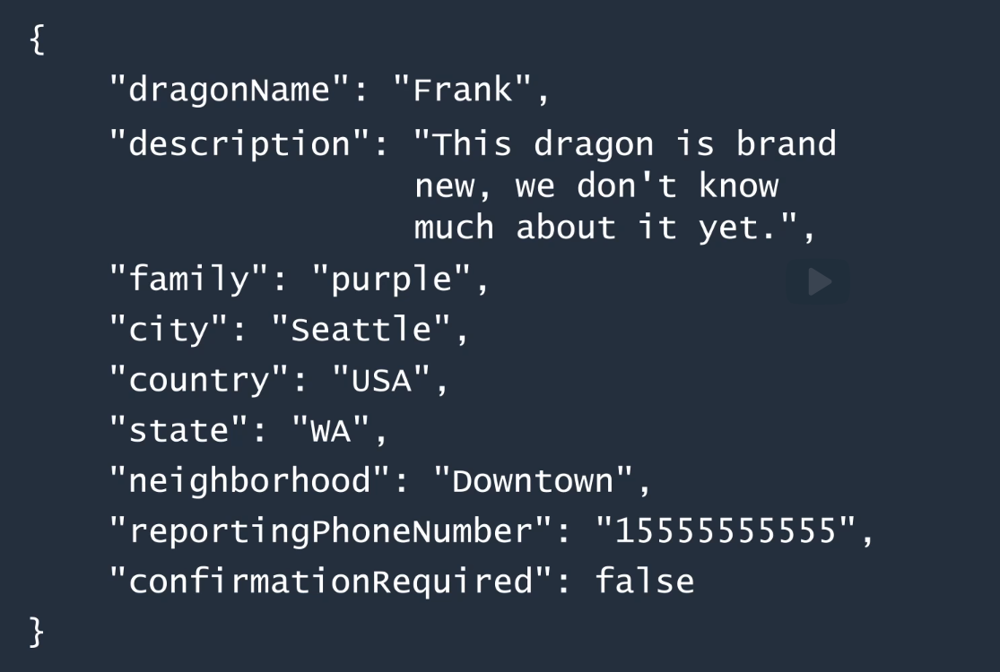
  
And this is what the JSON schema for that payload would look like.  
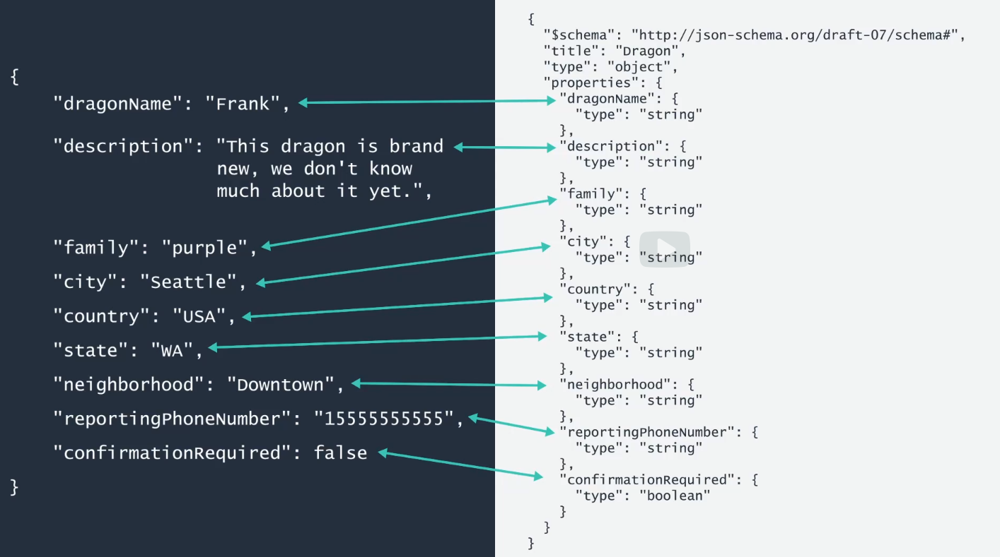

This schema is used to do request validation.  
  
  
Models can be applied to both method requests and method responses. You have API Gateway, checking the structure of the data on the way in and on the way out. It's also important to note that each method for resource like GET, POST, etc. could have different models. So these get applied at the method level, not at the resource level.  
  
Next up are mappings.  
It's fairly common to run into situations where your back end services are expecting incoming data in a different format than the client is sending, or vice versa. Instead of having to change your code to support the clients data structure, wouldn't it be nice if API Gateway could handle that for you? Luckily, it can.  
And you can use mappings to do this.  
Mappings are applied to the integration request and integration response of your API. They're used for REST HTTP integrations,
not proxy integrations, which just take the data as is, and passes it to the backend service without transformation.  
These mappings, like models, are also applied at the method level and each method under a resource can have its own mappings.
Mappings are written in Velocity Template Language, or VTL. If you already have defined a model for the method, API Gateway can generate a VTL blueprint for the mapping which you can then modify.  
A mapping template assumes the data coming in as a JSON object by default, and mappings do support other data types like XML.
Mappings support conditional statements, can inject new parameters into the payload, can hardcode values, which is needed for mocking, map data in complex structures, and can even reference data made available at runtime, such as context and stage variables.

<pre>

    
</pre>
### Creating a GET API with Mock Integration



Previously mentioned, enables your API to return a response for a request directly, without the need for a resource on the backend. This is a way to develop the API independently from the other parts of your distributed application.  
What you see here, is the flow of the requests and responses that Morgan set up. Having a mock endpoint return a blank response,
isn't very helpful for testing.  
So, we are going to be mocking what a real backend would do.  
This way, any clients being developed, can make requests to the API and receive data back as if there was a backend there. 
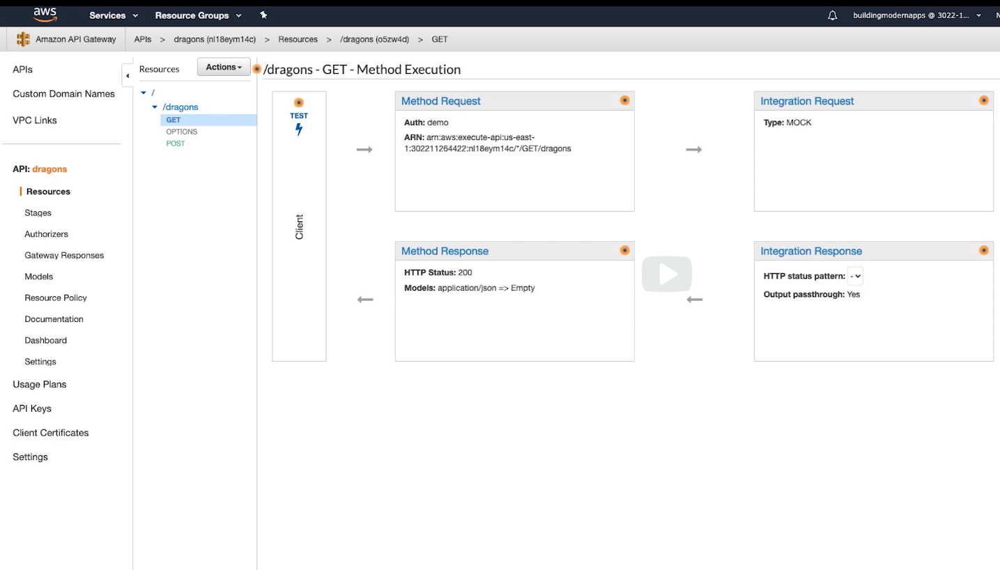

Because I can decide how API gateway responds to a mock integration request, I can configure the methods integration request
and response to associated response with a given status code.  
  
Mappings allow you to match parameters one to one and map a family of integration response status codes, matched by a regular expression to a single response status code.  
So now that I have my empty mock backend established, I want to set up the response for the integration.  
I go into integration response   
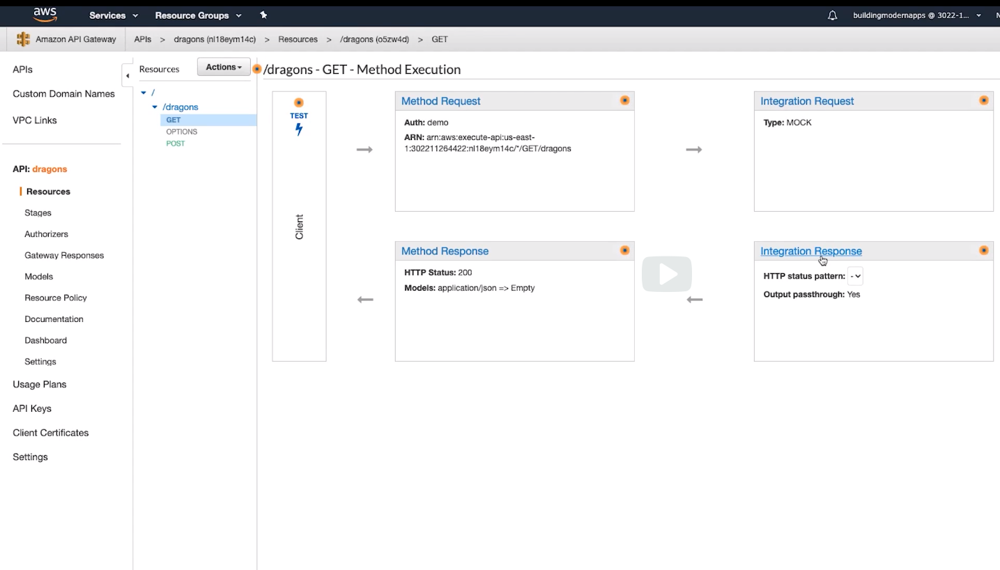

and expand the 200 method response status that we see already there.  
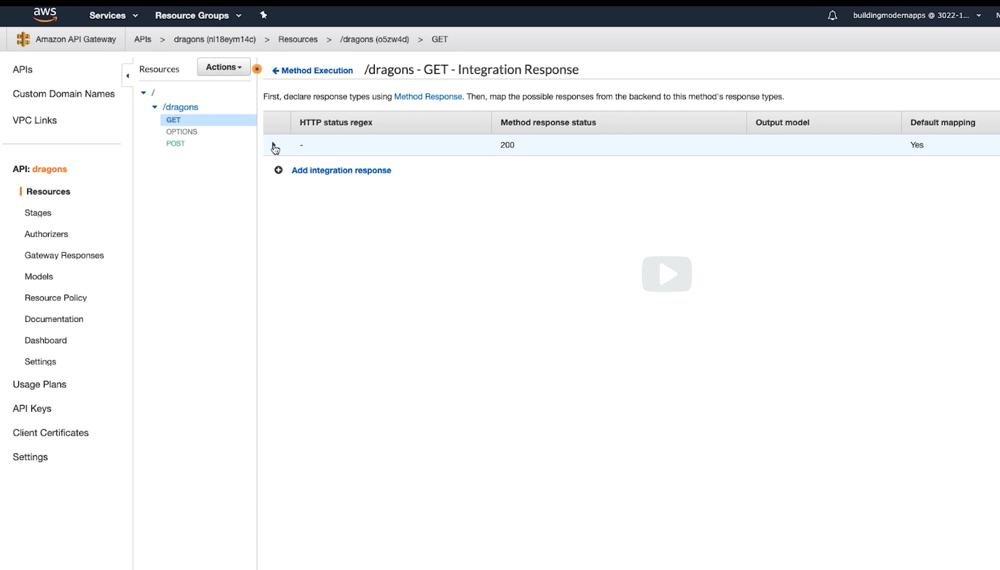

After that, I'll expand mapping templates  
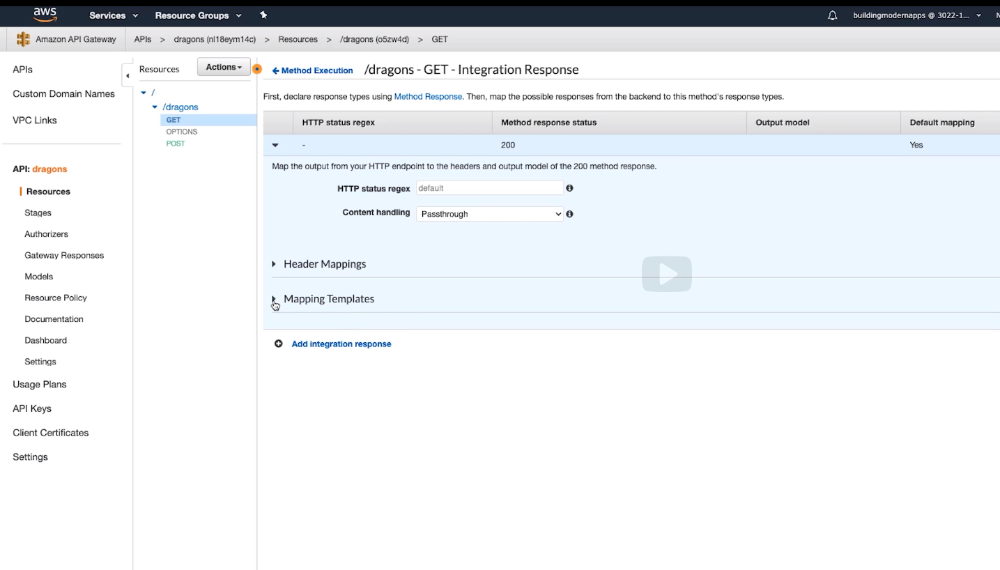

and select application/json that already exists under the content type.  
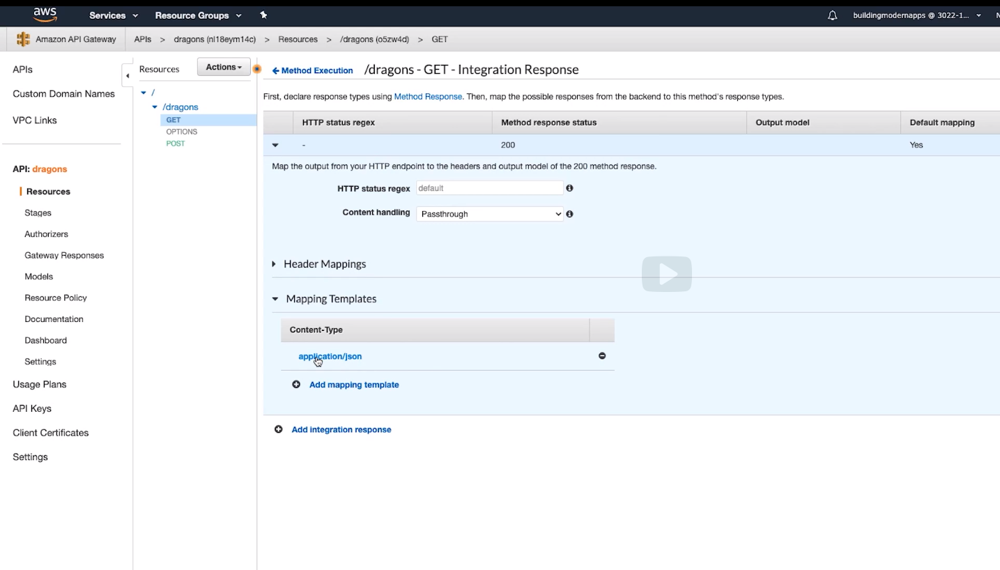

This is where I can put my hard-coded response as you see me doing now.  
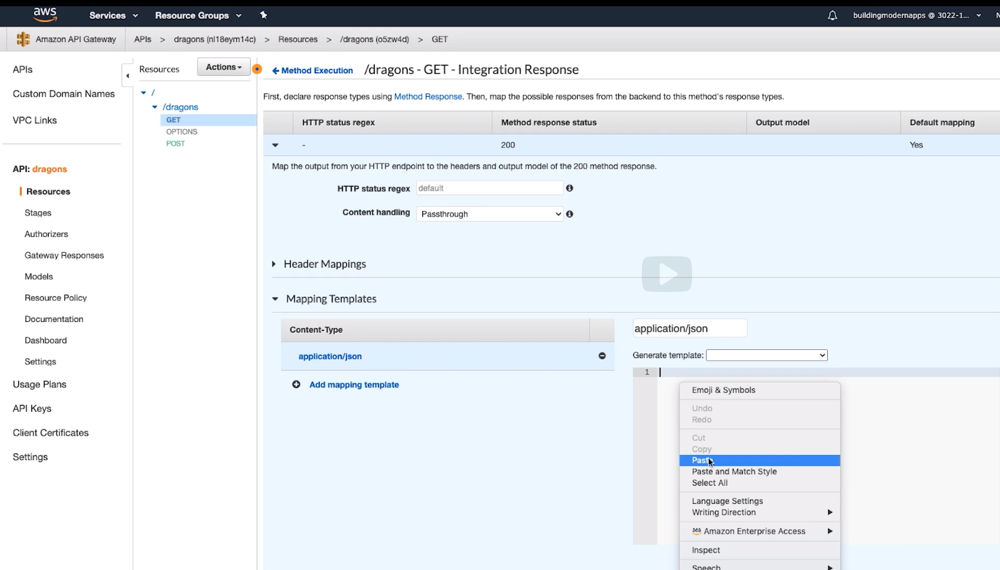

The data is static, but it gives the appearance of a working API.  
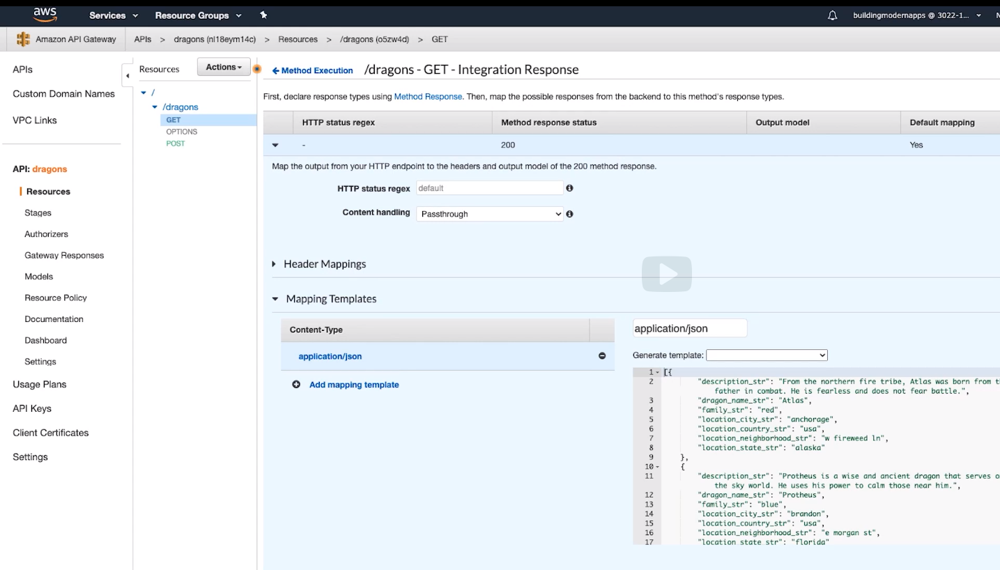

I already have the dragon data that I want to set up for the response. So I'm going to save the mapping and test my API.   
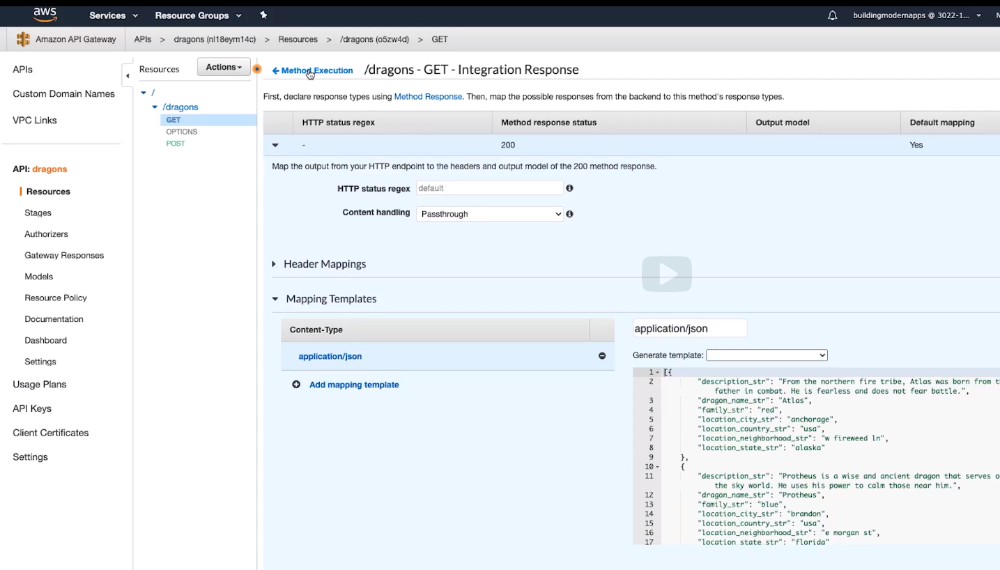

For this test, I'm going to leave all inputs blank since I don't have anything to adjust, and after clicking test  
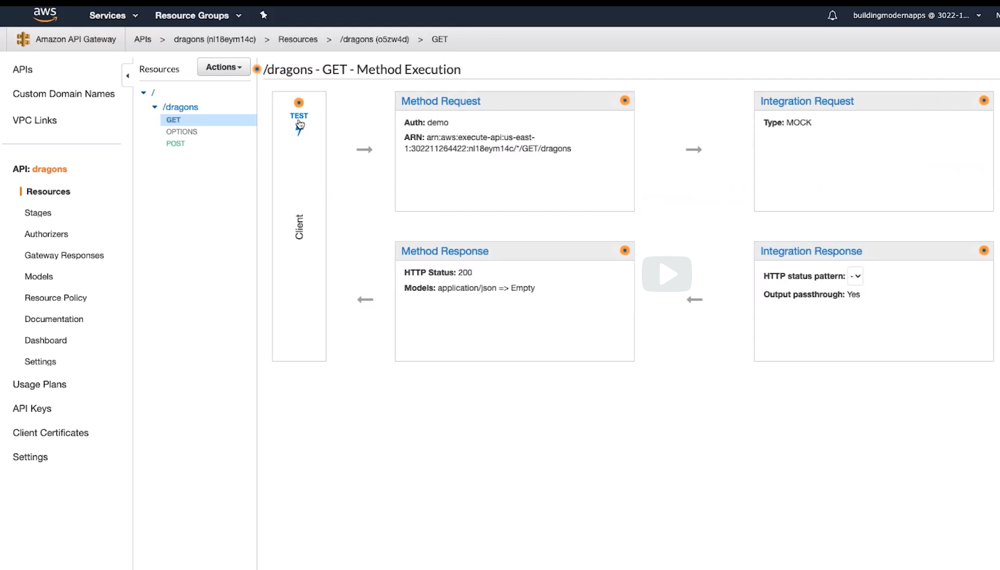

And  

  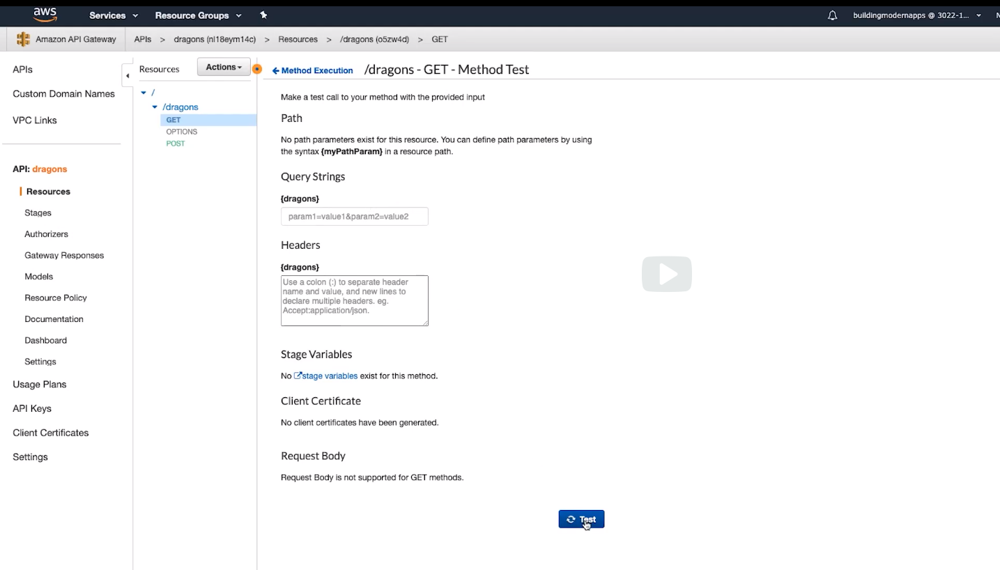
  
we see the hard-coded data is coming back in the side pane here.  
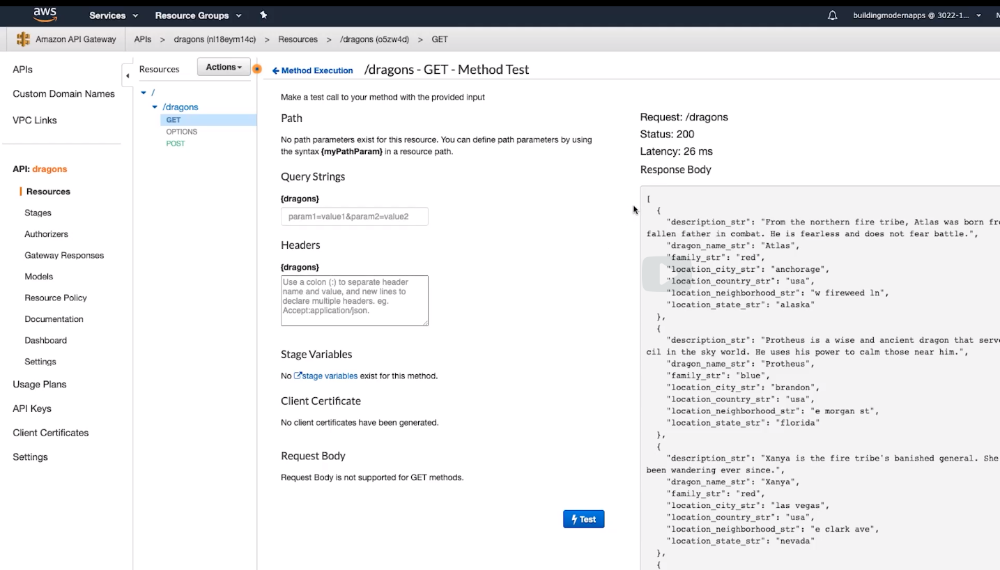

That does it for this part of the demonstrated build.
What you'll see next is the addition of the functionality for the query parameters, that enable querying the data by dragon family and dragon name. 


<pre>


    
</pre>
### Dragon API: Using Mappings

Now that you have an API created for your dragon data and a basic GET method that returns some hard coded data what we need to do now is ensure that our mocked API can account for the fact that when we submit a GET request to our API, we could be trying to list all dragons, list dragons by family, or list dragons by name.  
One method will be handling all three of these use cases.  
When you submit a request, you will include a query parameter on the request, like this.
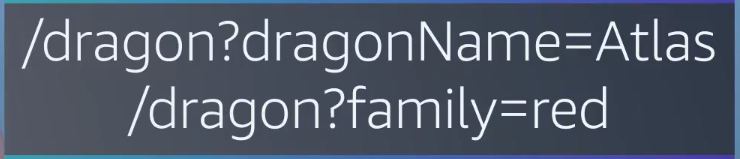

You can see the question mark, followed by the query parameters for family or dragon name.   
  
What we're going to do now is modify the mock endpoint to respond with different data if one of these query parameters is present. That way, our mock API will respond in a way that is similar to if it was the real thing, and it had a backend that was actually querying, based on the parameters coming in on the request.  
To make that happen, what I need to take advantage of is the mappings that were applied to the integration response.  
  
I'm going to modify the integration response to check the query parameters using conditionals in VTL. Since we do not have a real backend to serve the correct data, based on the query parameter, we will be hard coding it, so the API behaves as we expect it to.  
  
All right, I'm in the console and looking at the dragon API. What I'm going to do is click on the GET method.  
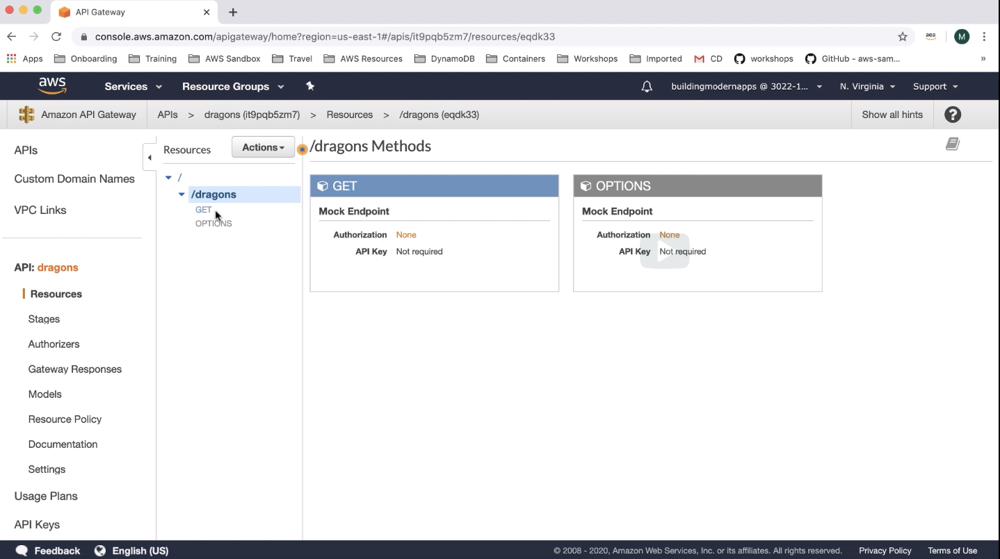
  
And then I'm going to click on the Integration Response.
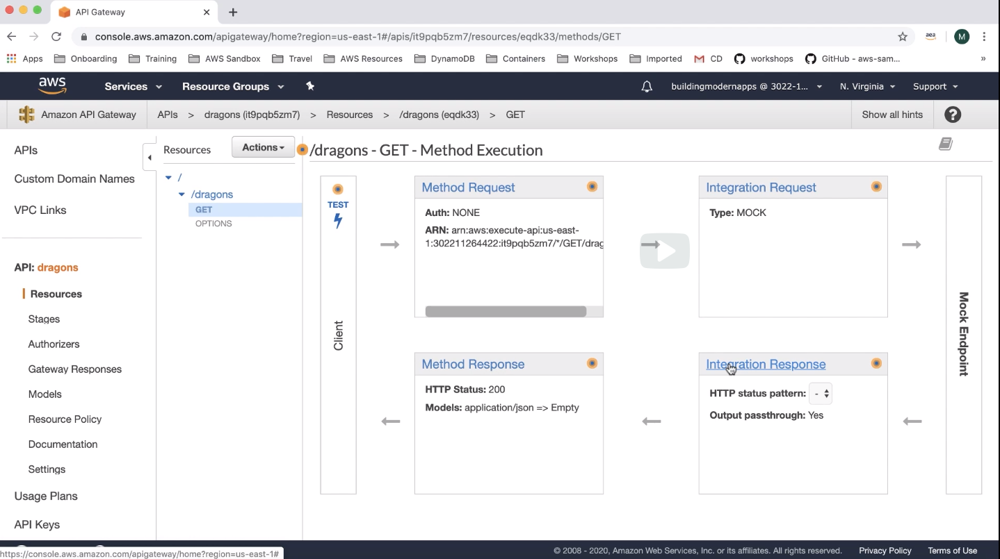

Then I will navigate to the existing mapping, which is under Mapping Templates, click on application/json.
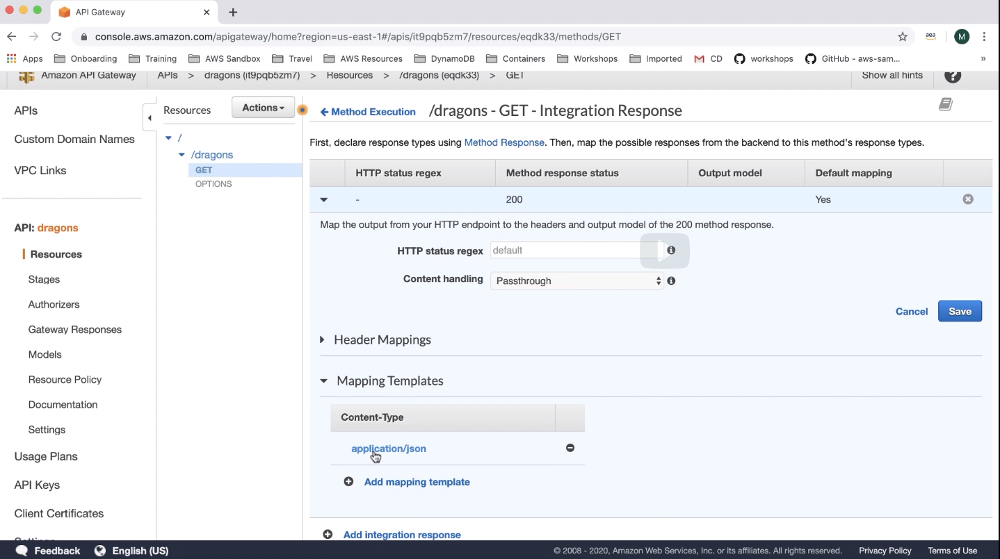
  
And then here we can see the existing mapping, and I'm going to just open this up, so we can see the existing mapping.
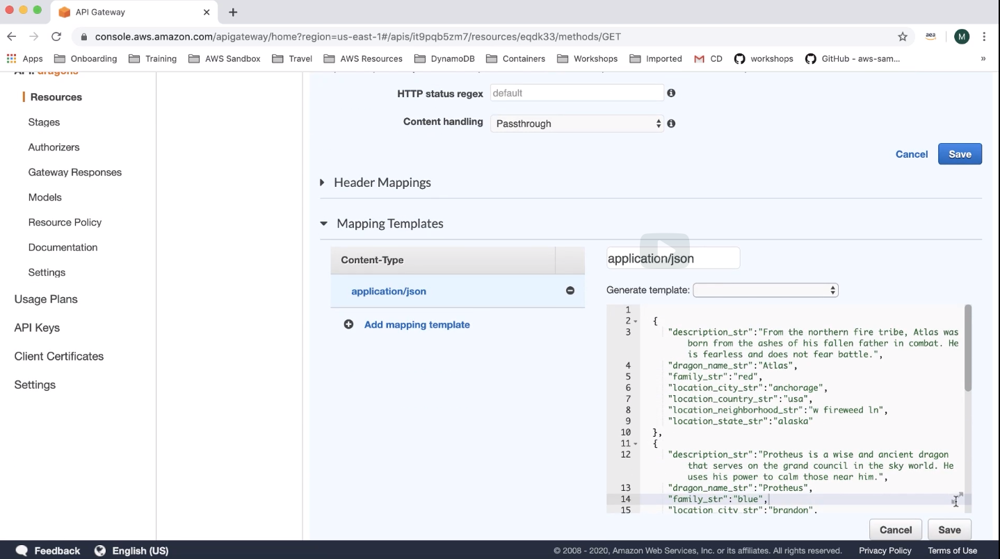
  
So this is the existing mapping we have right now.  
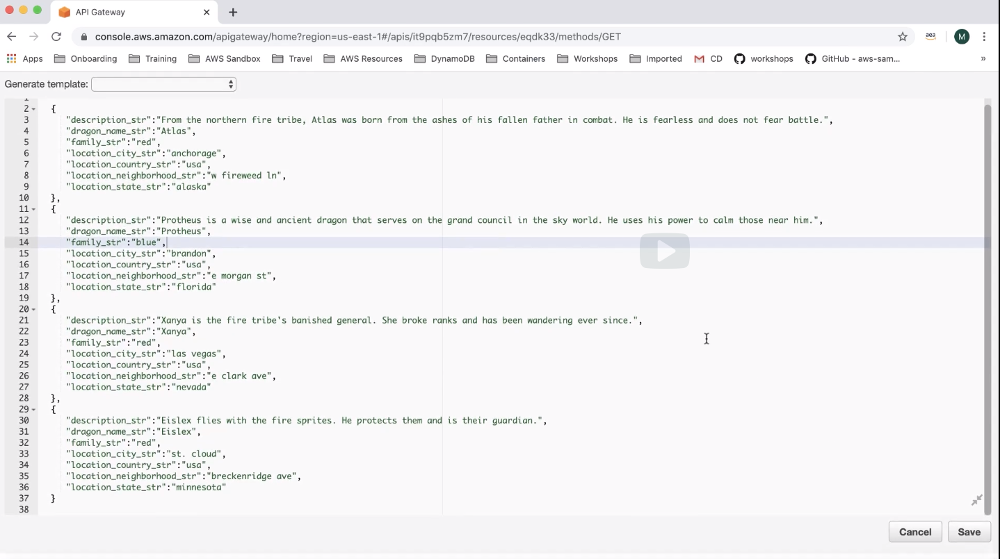
  
It's just hard coding some dragon data, just a few of them. So that way we can send some data back when somebody hits this API.  
  
Now, remember, mappings are written in VTL. This means I can use conditionals in my mapping. I'm going to add some VTL to this mapping using conditionals to handle the query parameters. All right, so now I'm just going to select all 
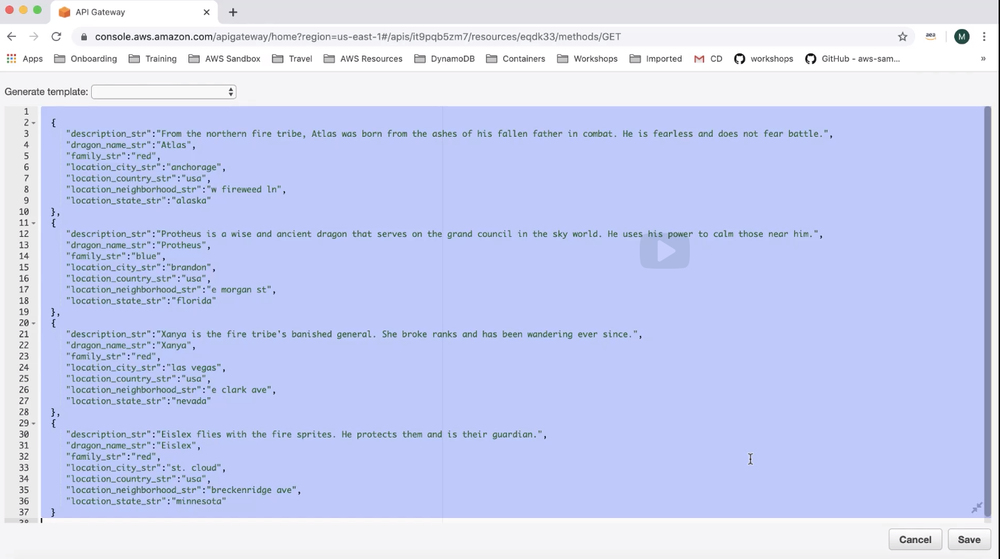
  
and paste. So I'm pasting over this and this is our new mapping.  
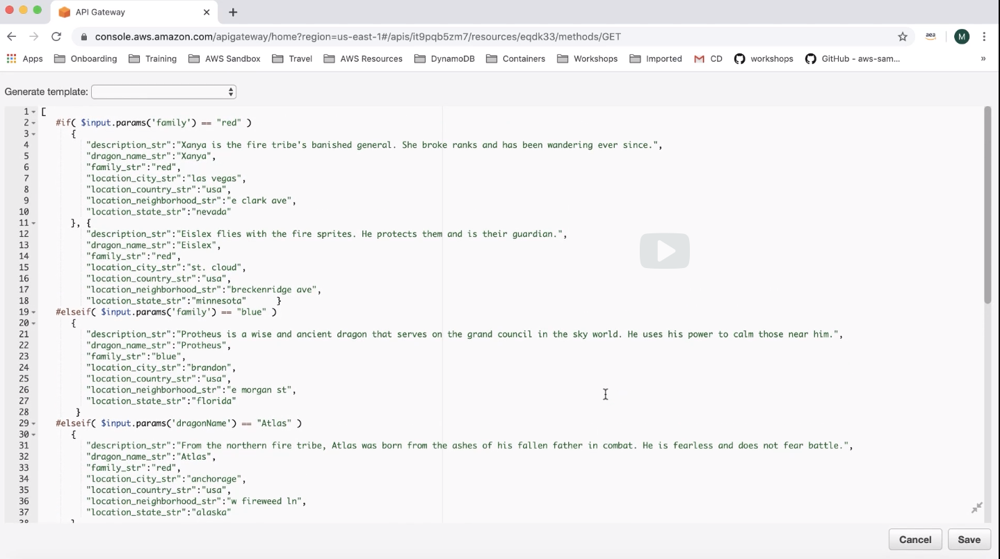
  
If we scroll through this, you can see I have some conditionals and I'm checking against this `$input.params`.  
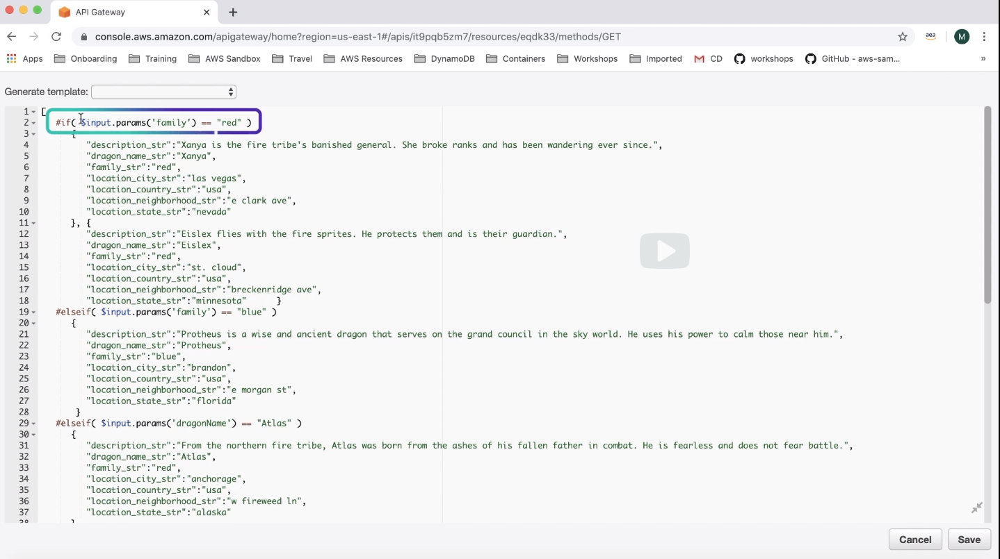
  
So what is this dollar input? API Gateway provides variables that start with a dollar sign that give you access to payload and context information in your mappings. In this case, the dollar input variable is giving the mapping access to the request, payload and parameters. We are then calling .params on the input,  
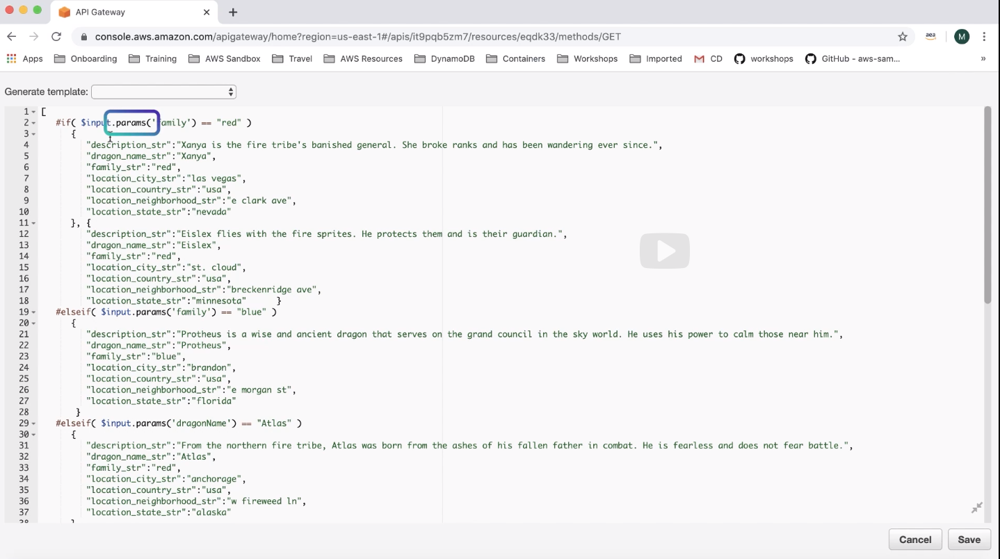
  
which will return a map of the parameters on the request. And we are then also providing the name of the parameter we are looking for, so that this will return
the value of that parameter. We know that we will be using query parameters to filter the dragon data, so we are checking the values of the parameters coming in
and responding accordingly with varying data. There are other variables that API Gateway allows you to use in your mapping templates, similar to this dollar input, like dollar context, dollar util and dollar stage variables, which you can read about in the class notes.  

So if I scroll down here, you can see we have, if the input params is red, then we respond with some red dragons. If the family is blue, then we respond with some blue dragons. If the dragon name that they're filtering on is Atlas, then we'll respond with one dragon. And then else will just give them what we had in here originally, which was just four hard-coded dragons. So let's go ahead and save this.  
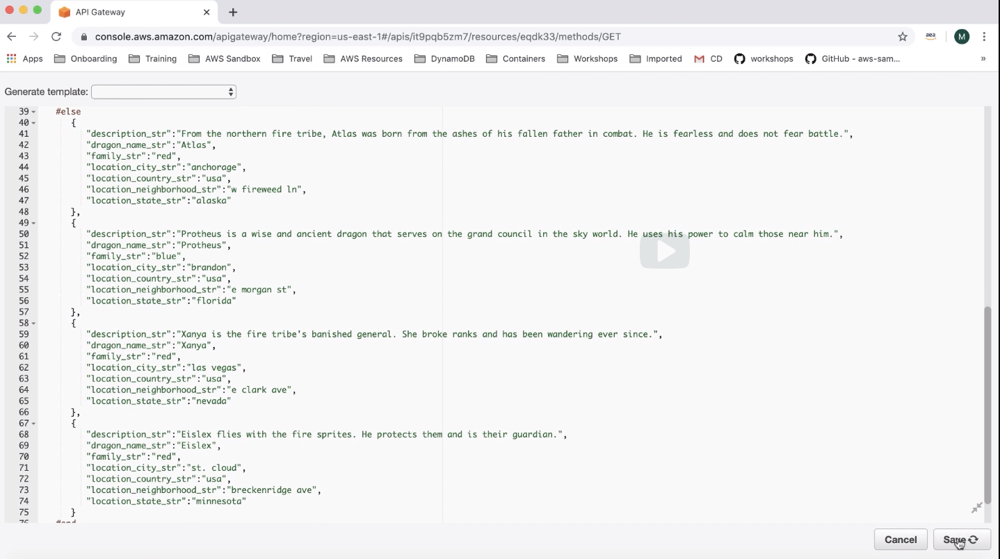
  
And then I'm going to back out of this by clicking method execution   
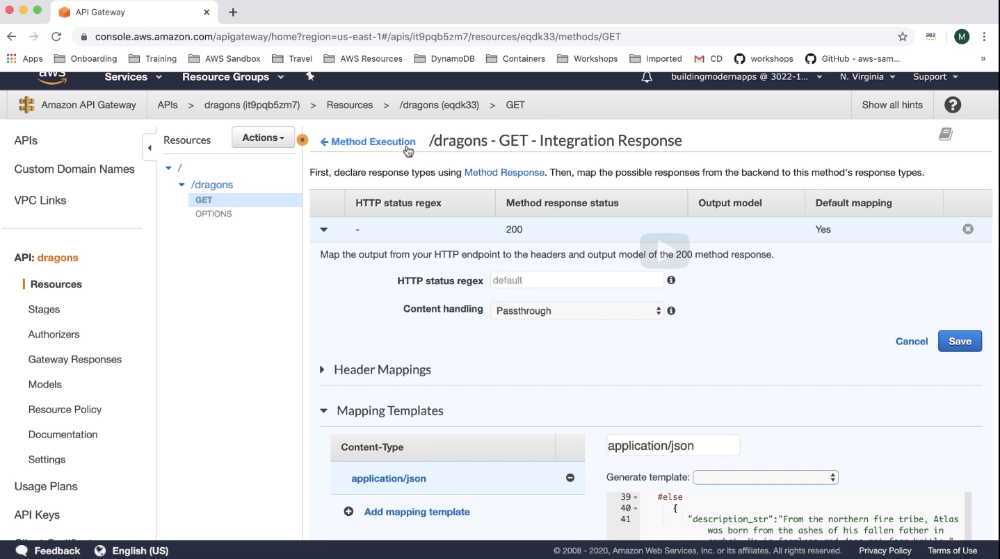
  
and then test.    
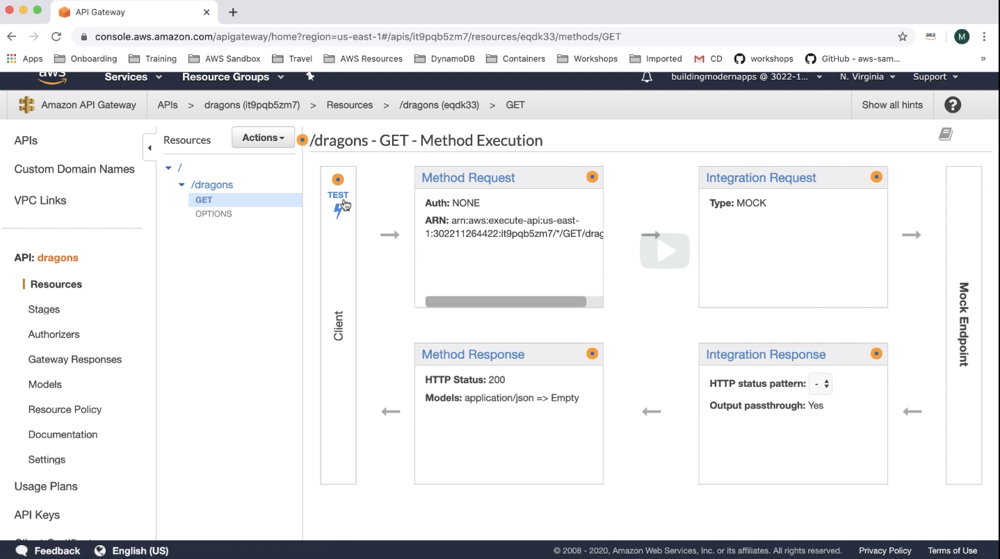
  
So now I have the ability from this test screen to add in some query parameters. So if I type in `dragonName=Atlas` and I scroll down and then I click test  
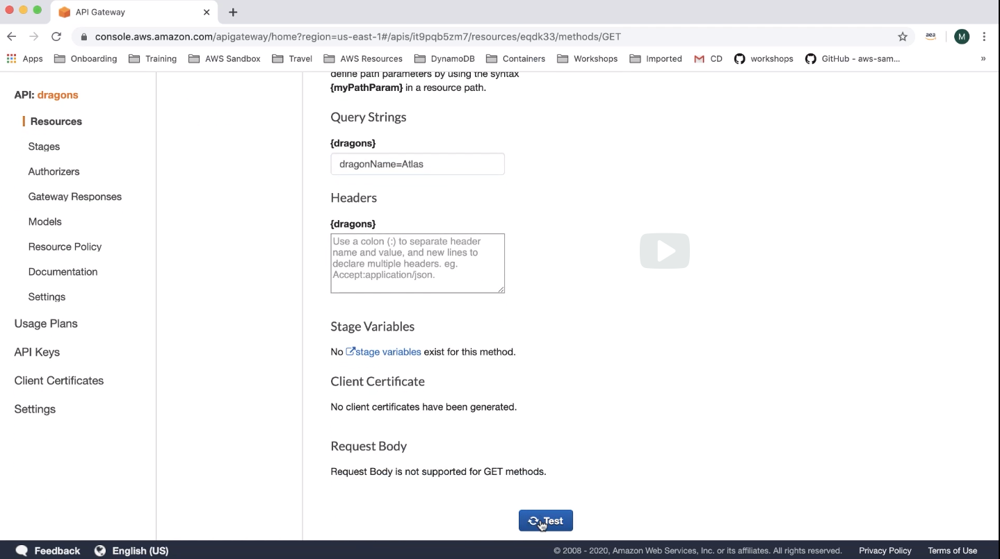
  
you can see over here on the right hand side in the response body, we got back just the Atlas dragon.  
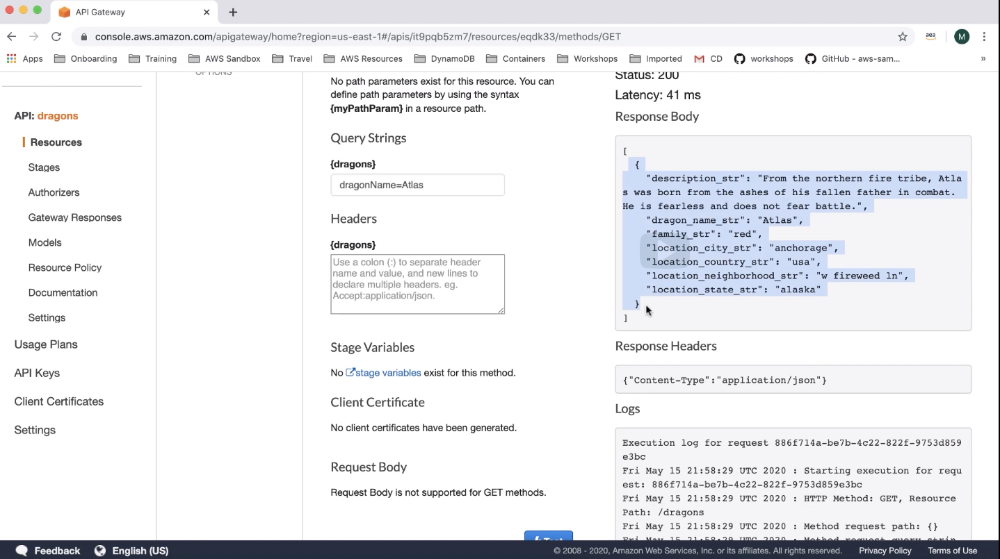
  
So it just responded with one dragon, which is what we're looking for.  
  
Now, let's test out if I said `family=red` and click test.  
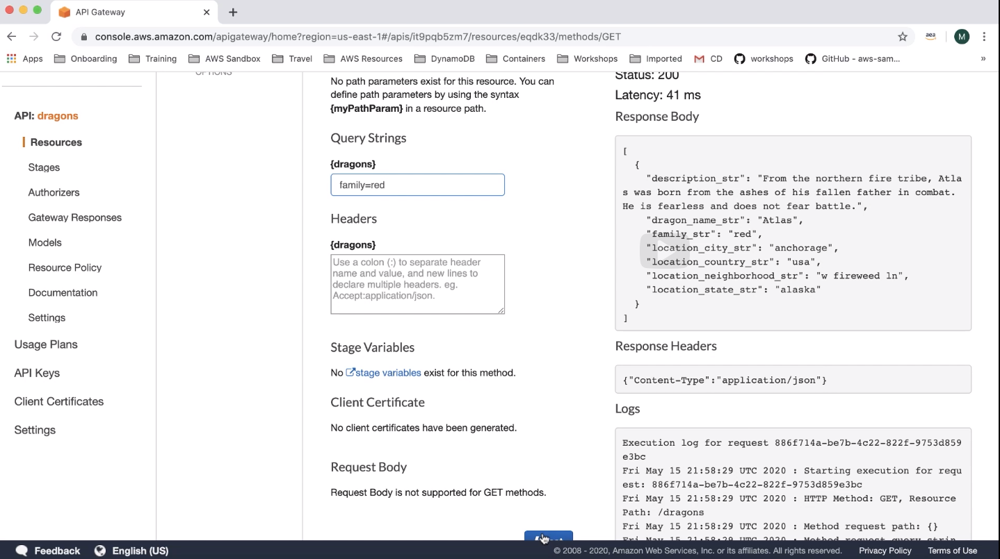
  
And you can see I got back the two red dragons.  
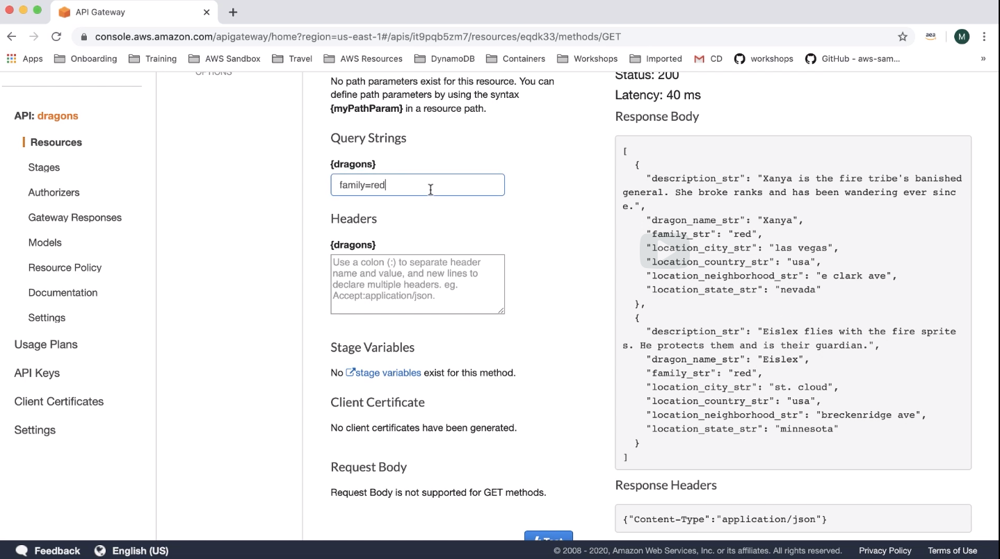
  
And now if I typed in `family=blue`  
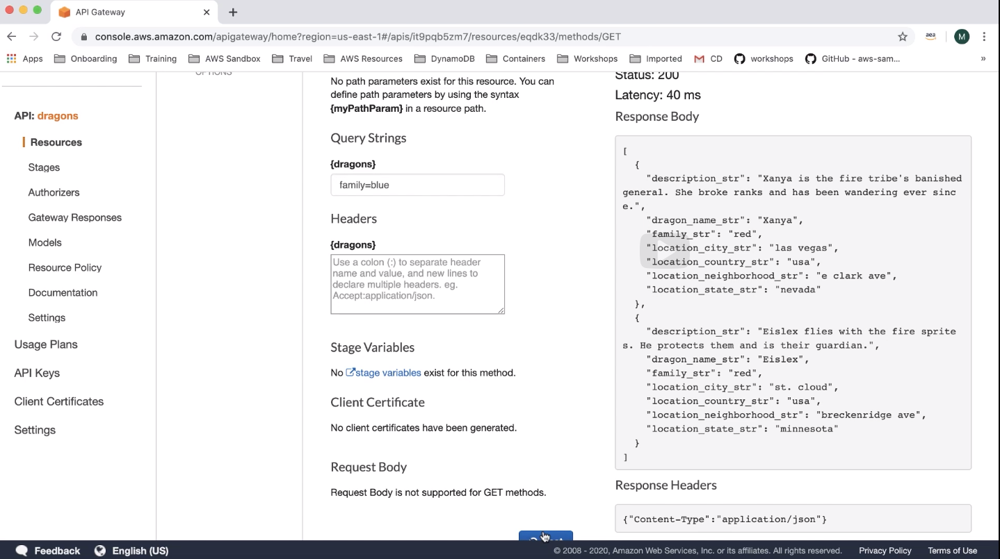
  
I get the one blue dragon.  
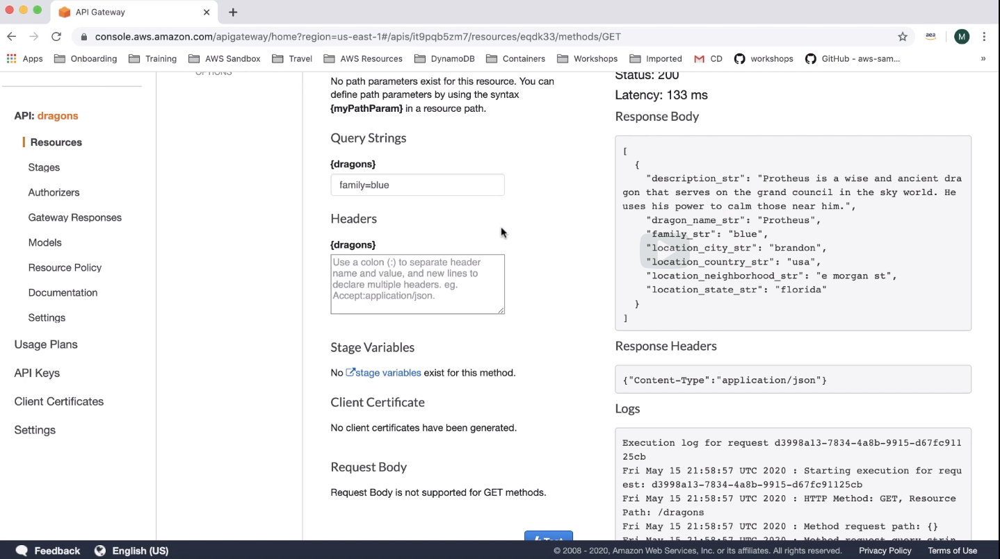
  
And then finally, if I just leave it all blank,  
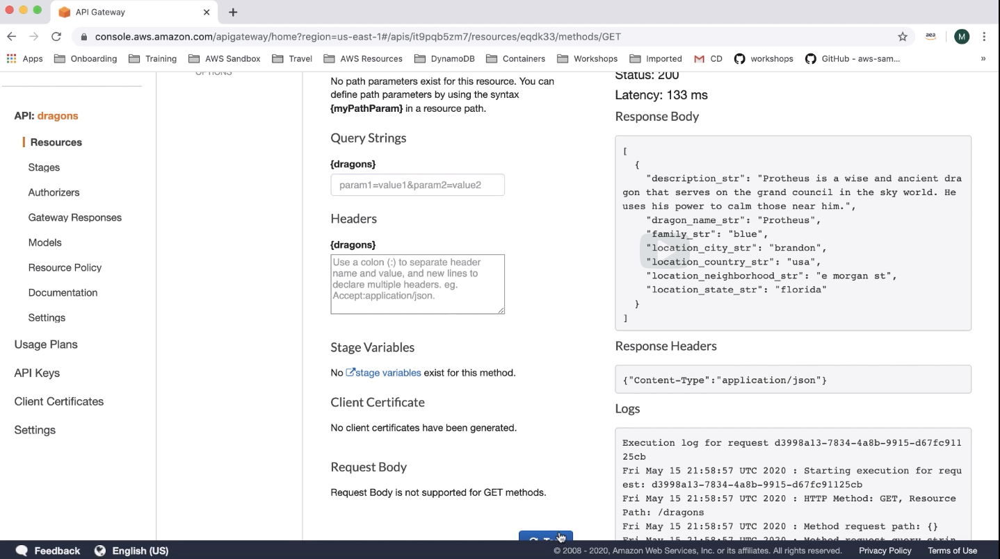
  
it returns all of the dragons back to me.  
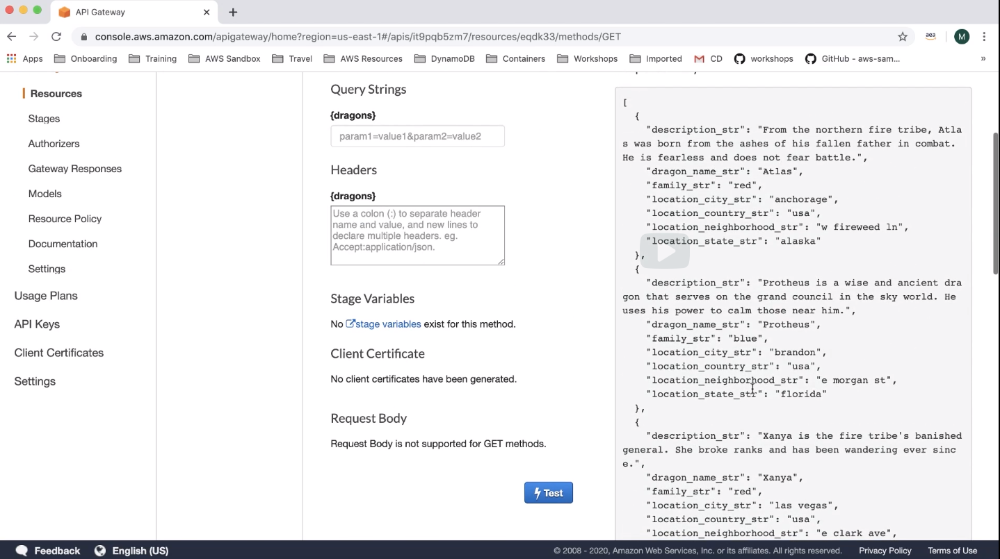
  
This API is responding as if there is a backend but there isn't. This method is now fully mocked up and we can move on to the next method.

<pre>

    
</pre>
### DragonAPI: Using Models

Let's continue to build out our dragon API and move on to adding the method that will handle the reporting a new dragon. I'm first going to add a new POST method to the dragons resource so let's do that first. 
To add the POST method, you'll click actions  
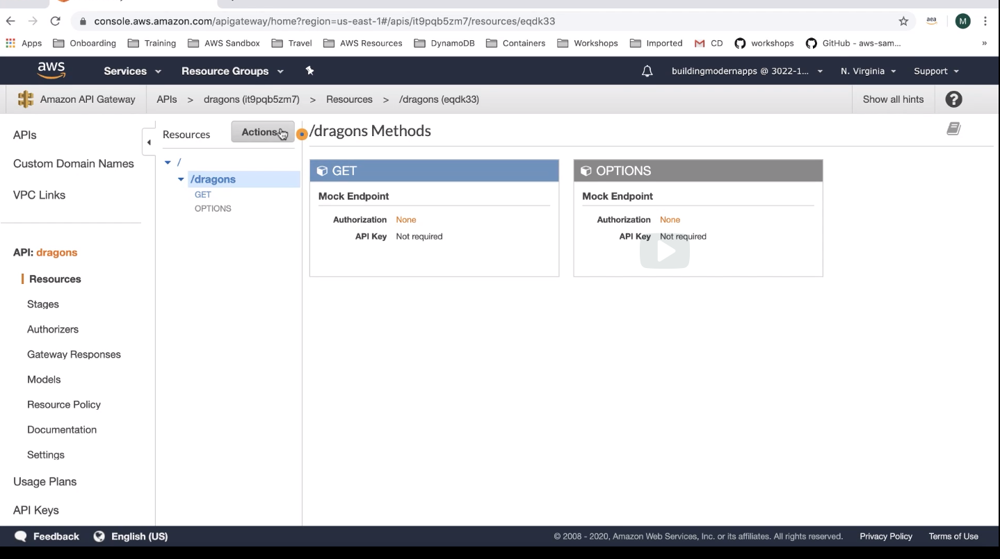
  
create method  
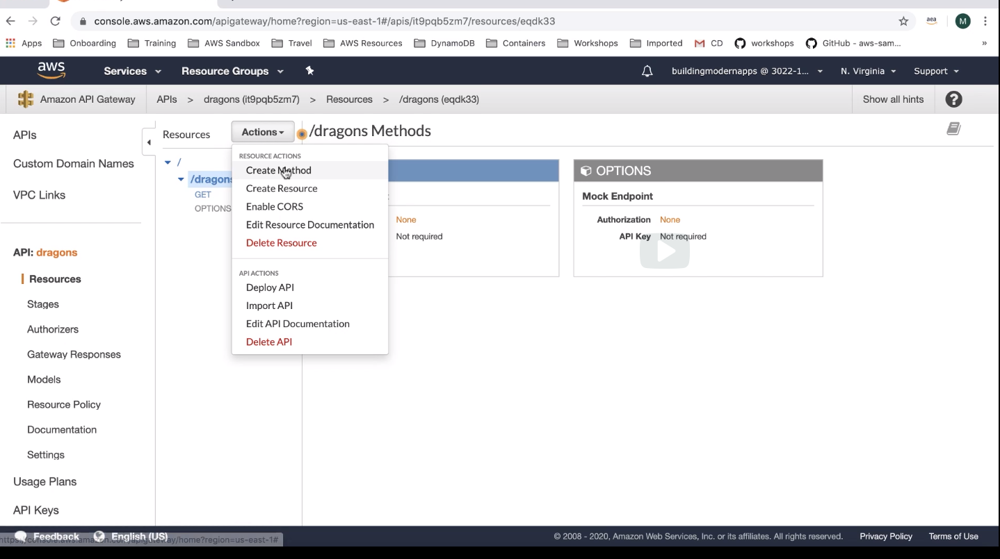
  
select the dropdown, click POST  
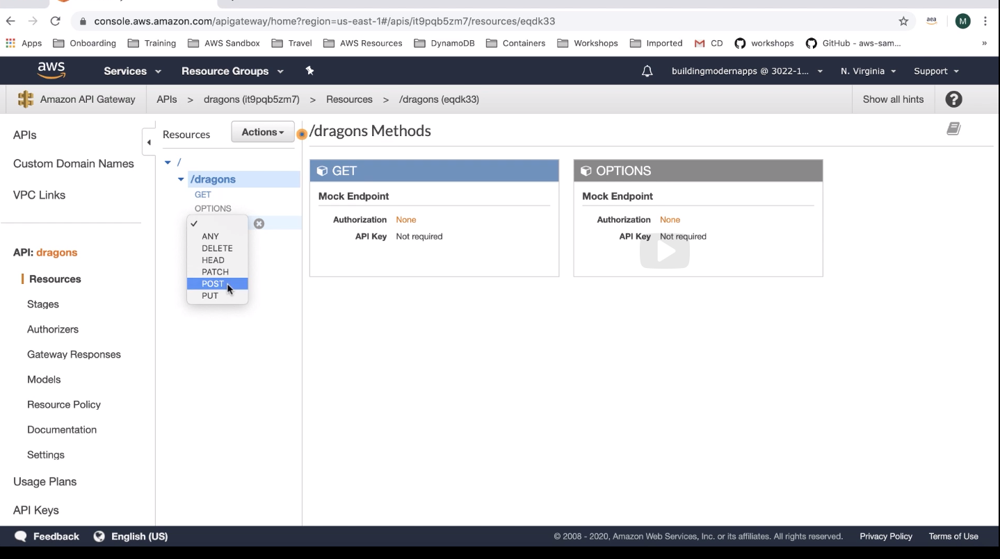
  
and then click the checkbox.  
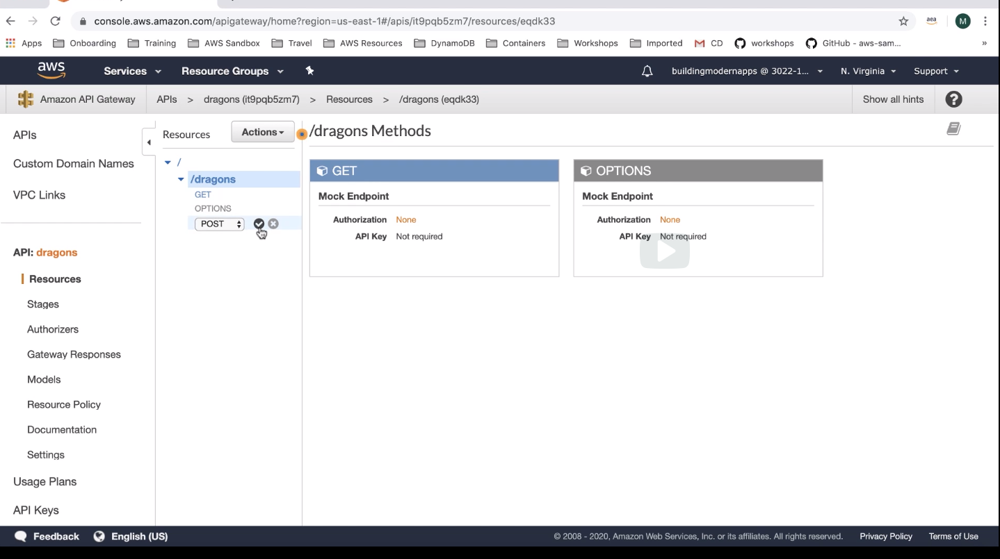
  
That brings us to this setup where we choose the integration point. This is also going to be a mock, so I will just select mock and then click save.
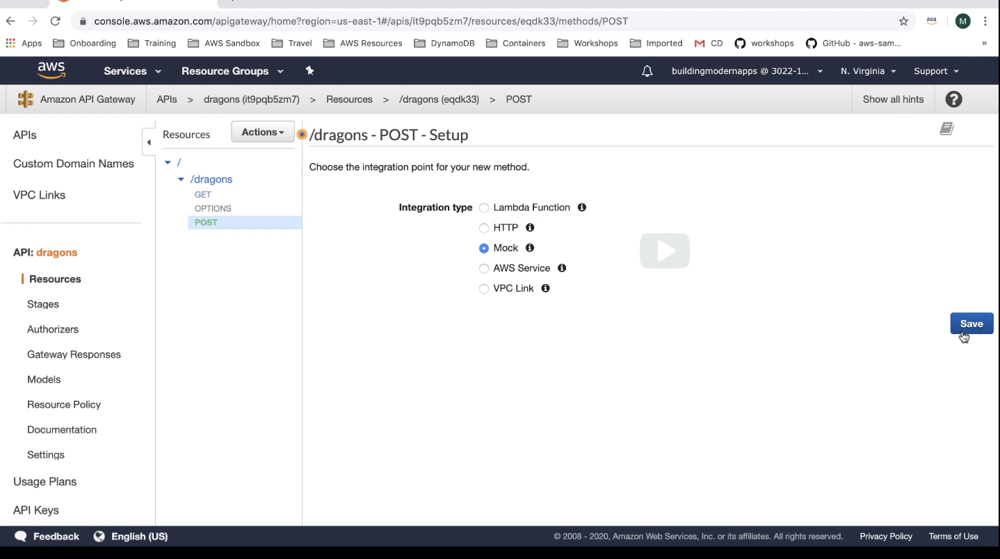
  
And that brings us to this method execution section where we can then see the four stages as well as the test.
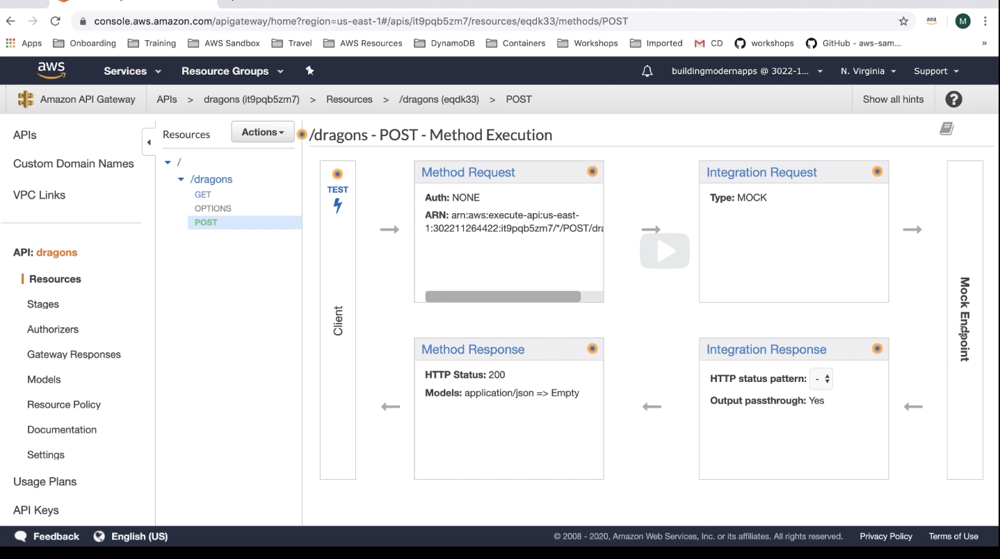
  
This method is going to be used for reporting new dragons so there will be a payload on the request that has the new dragons information. One of the features API Gateway has is to validate incoming requests based on models. Let's use that feature with this request. To make that happen, we first need to create a model. To do that, I'm going to click on the models section here
in the left-hand side.
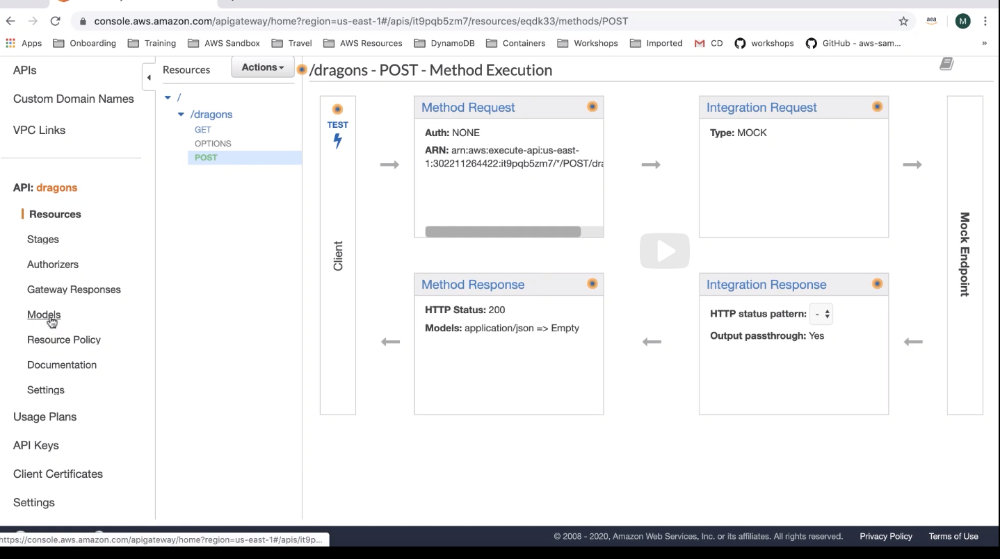
  
Models in API Gateway are JSON schemas. So from here, I'm going to click create,
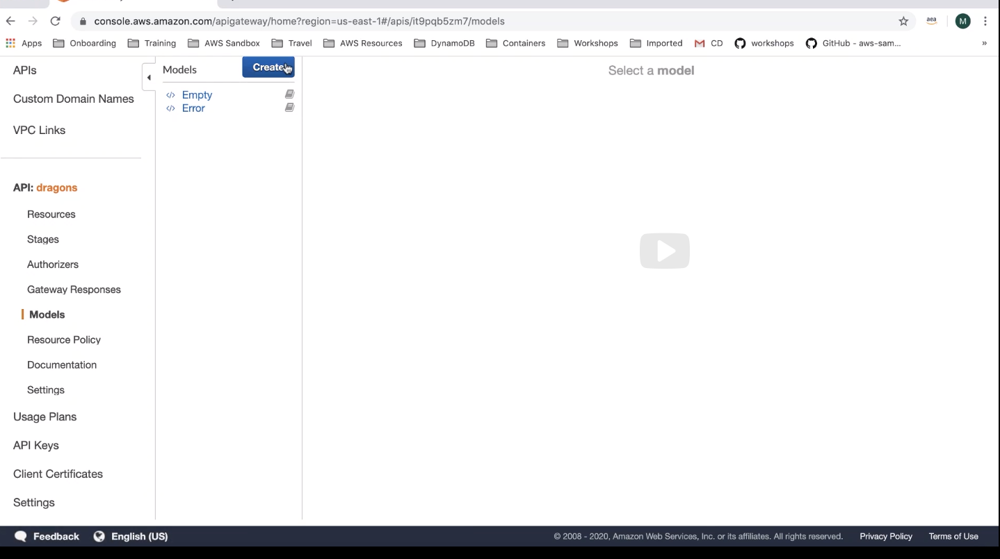
  
and then I'm going to paste in a pre-written JSON schema for the incoming dragon data that we expect to come in for the POST request. I'm going to name this dragon, and then I'm going to give it the content type application/JSON - and then click create model. 
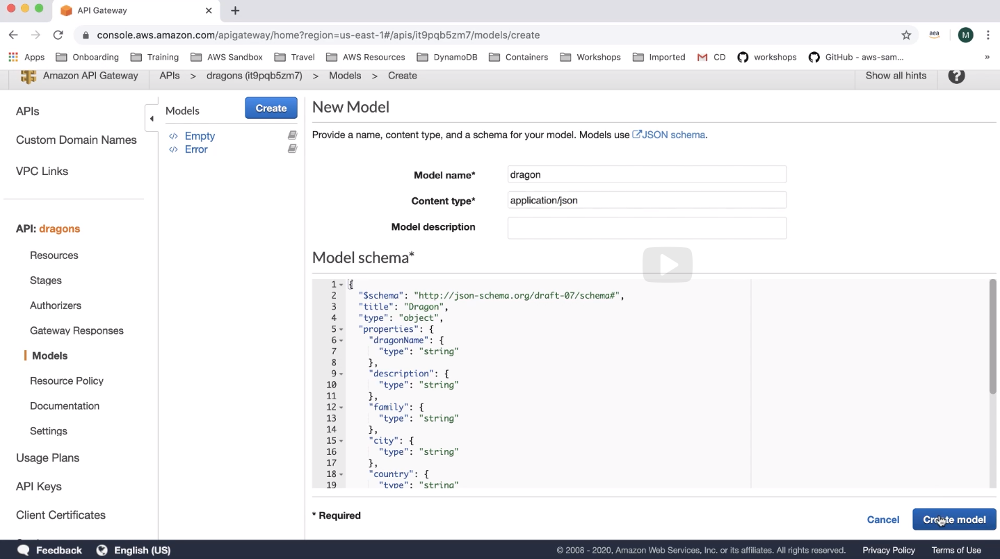
  
Based on this model, if the input deviates from the structure that we created, I want API Gateway to reject the request before it ever hits my backend. So now we have this model created, I'm going to go ahead and navigate back to our resources  
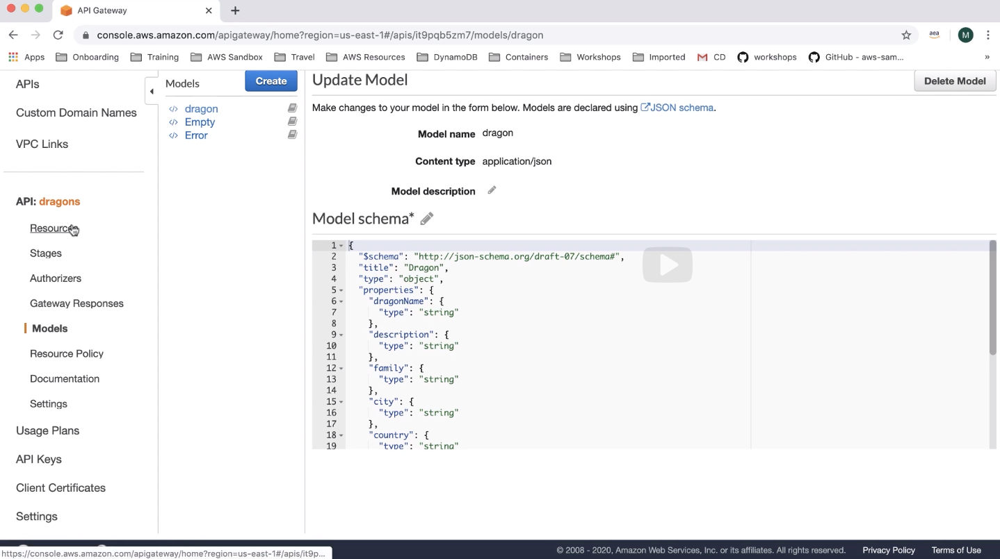
  
and then I'm going to navigate to the POST method because this is where we will apply that model.
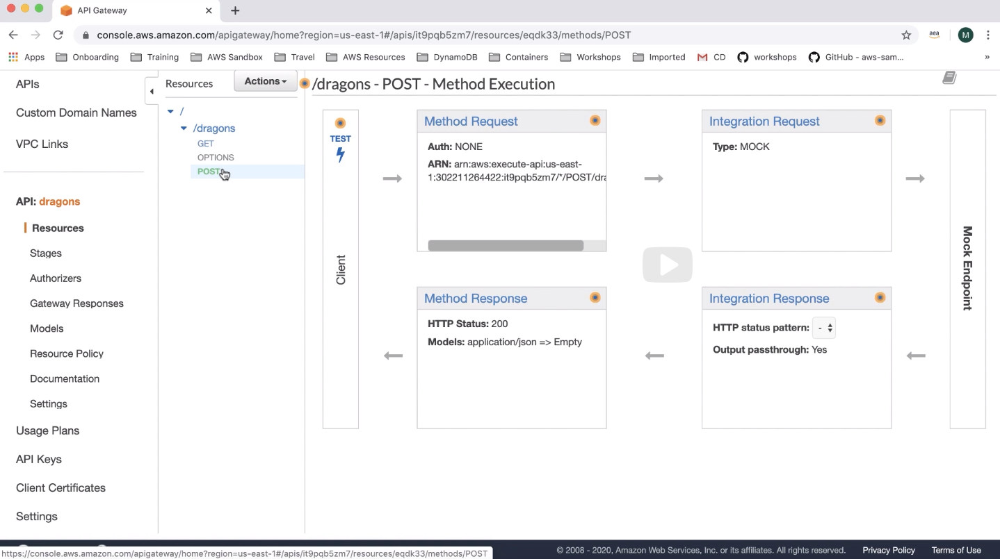
  
The place you apply request validation is on the method request so let's click on the method request
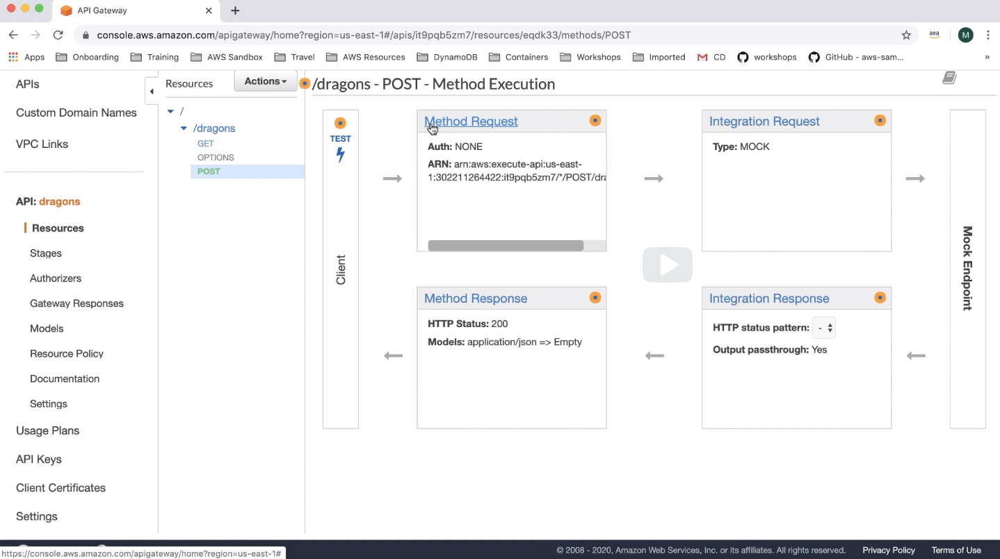
  
and then I am going to click on the request body 
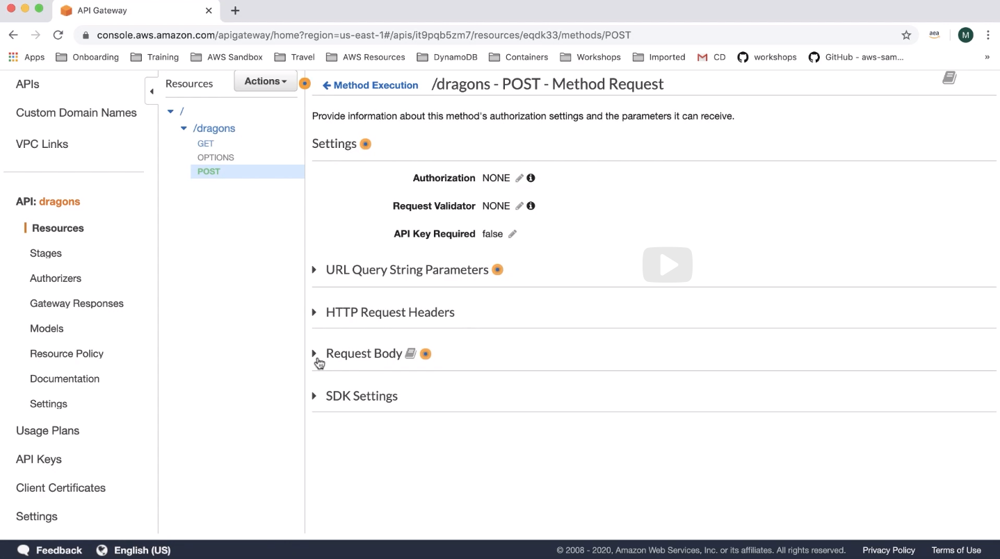
  
and I'm going to add a model
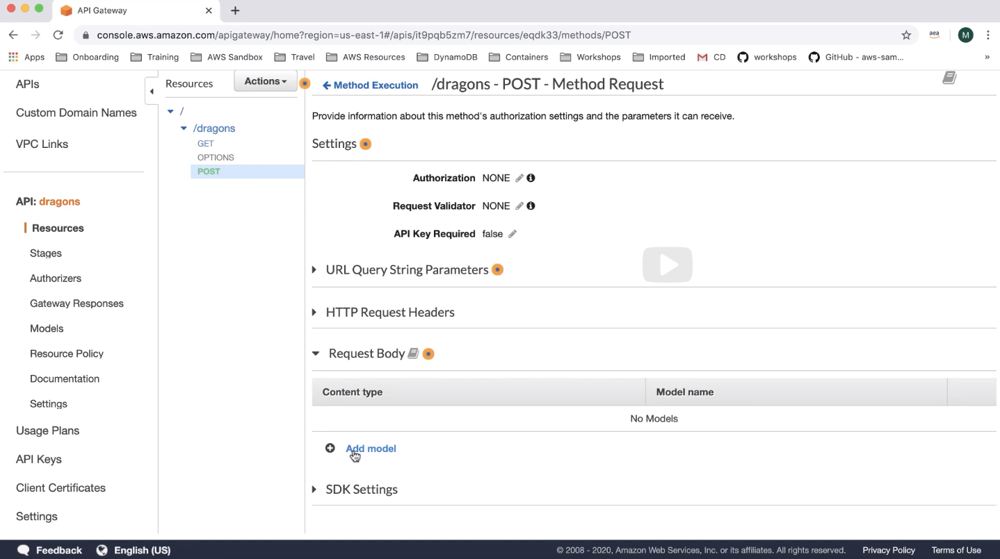
  
and we are going to select the dragon model that we just created,  
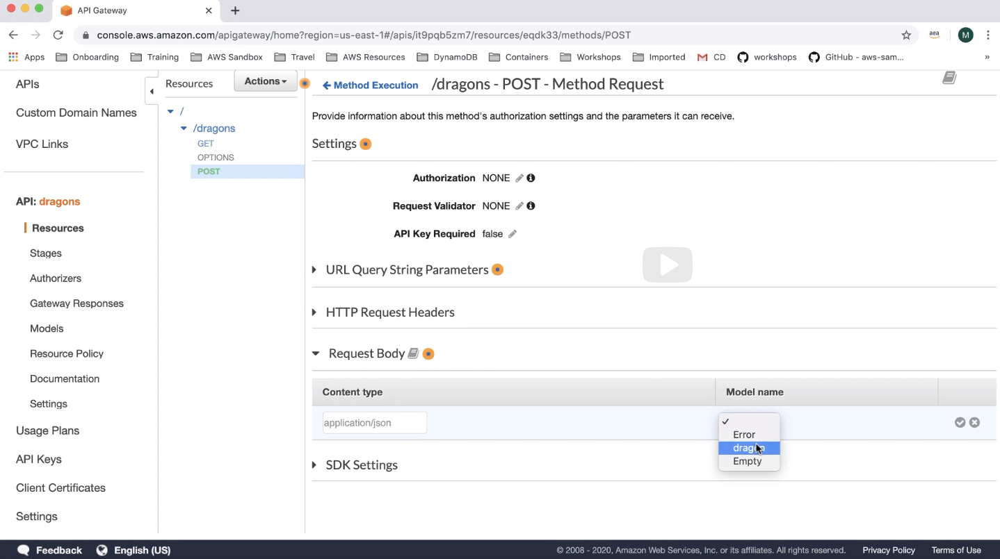
  
give it the application type application/JSON, and then I will click save.  
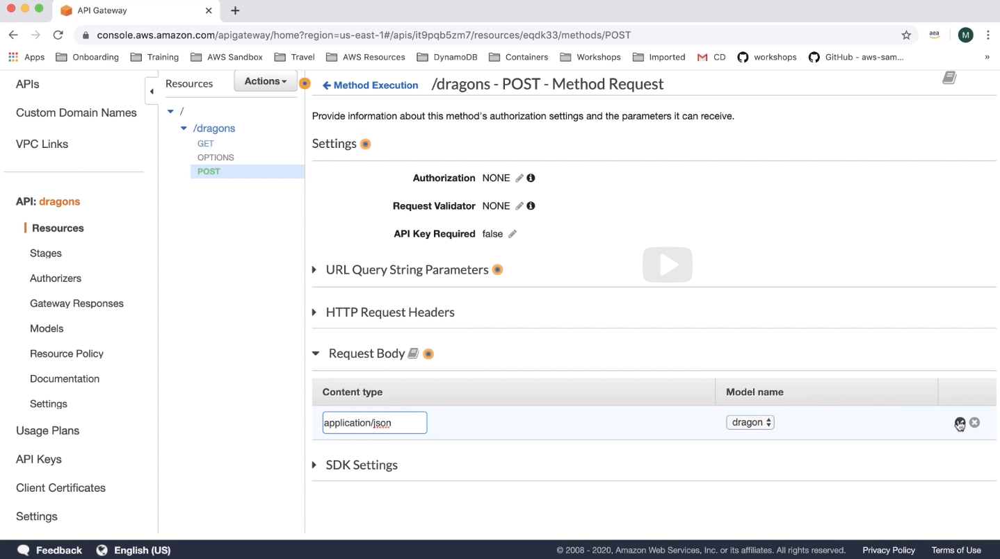
  
And then what I need to do to have it actually validate this is to select the request validator, click the pencil to edit it,
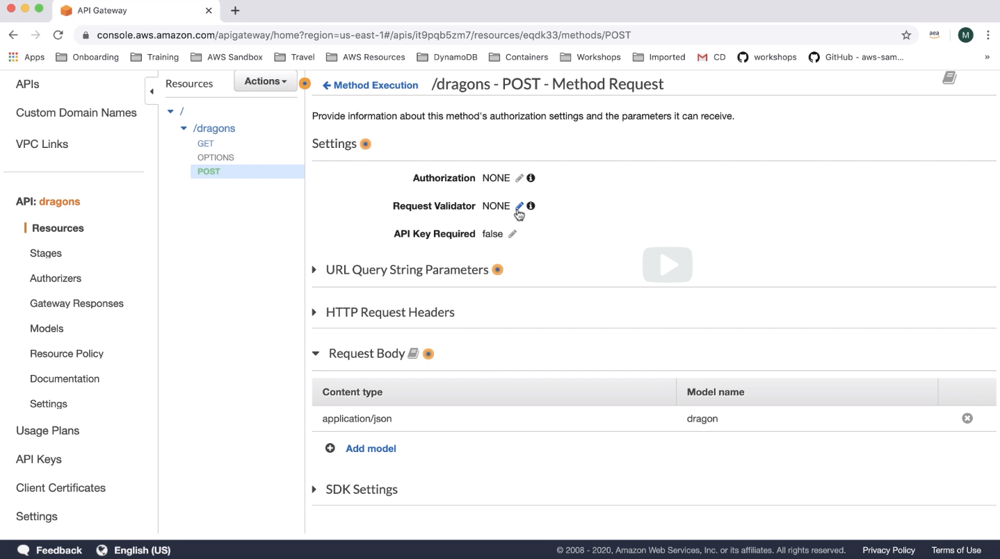
  
and then I want to validate the body  
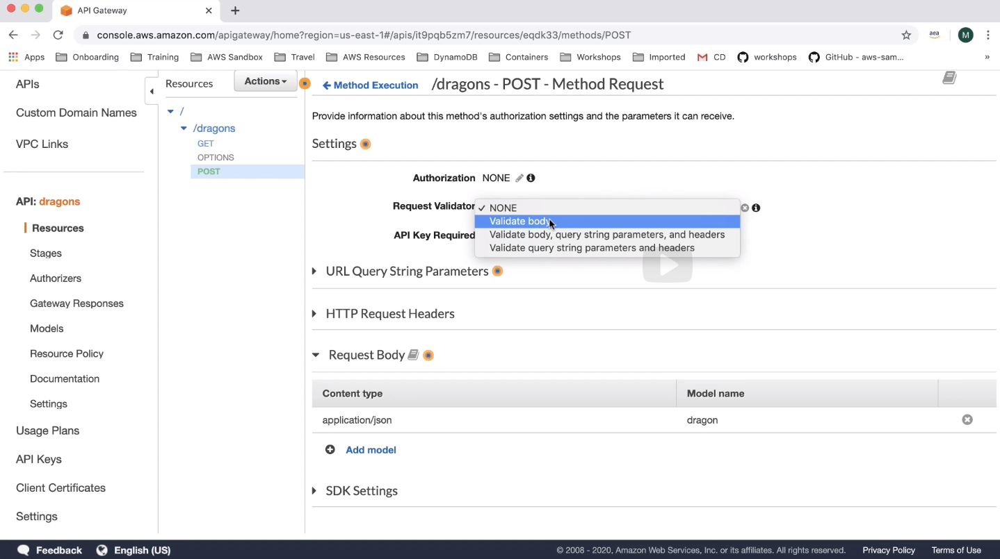
  
and then I'll click save there.  
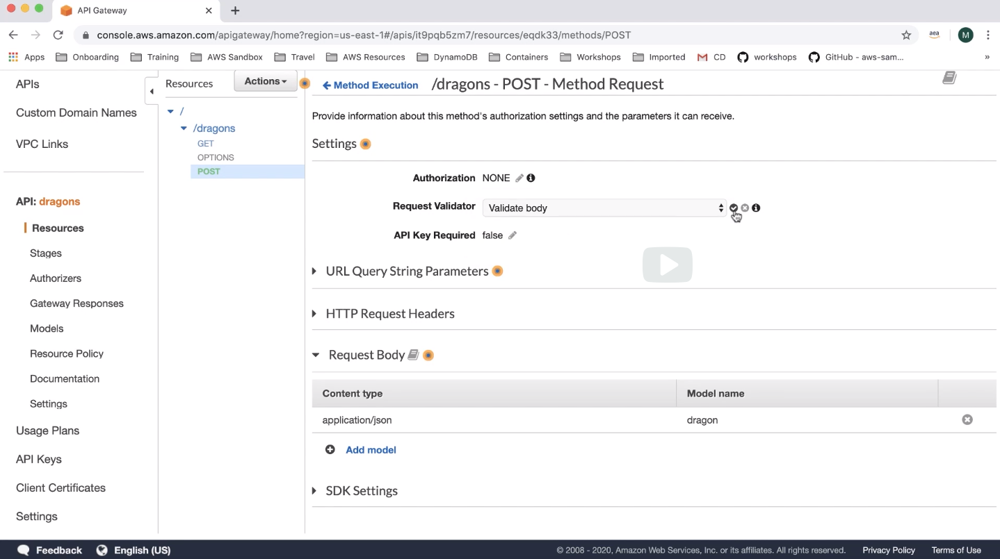
  
All right, so that's it. Let's go ahead and test it out.

If I back out here and then I click test,
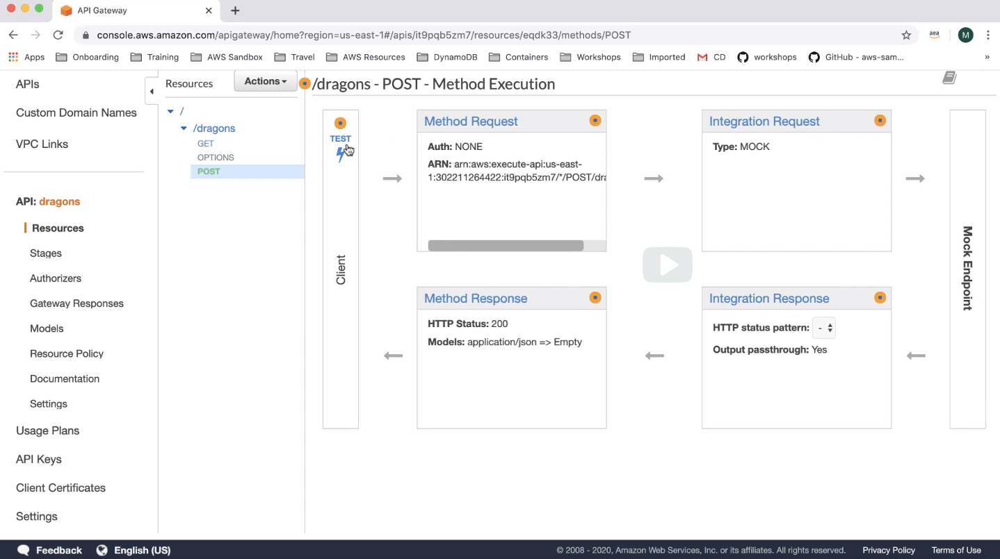
  
what we need to do now is test the POST method  
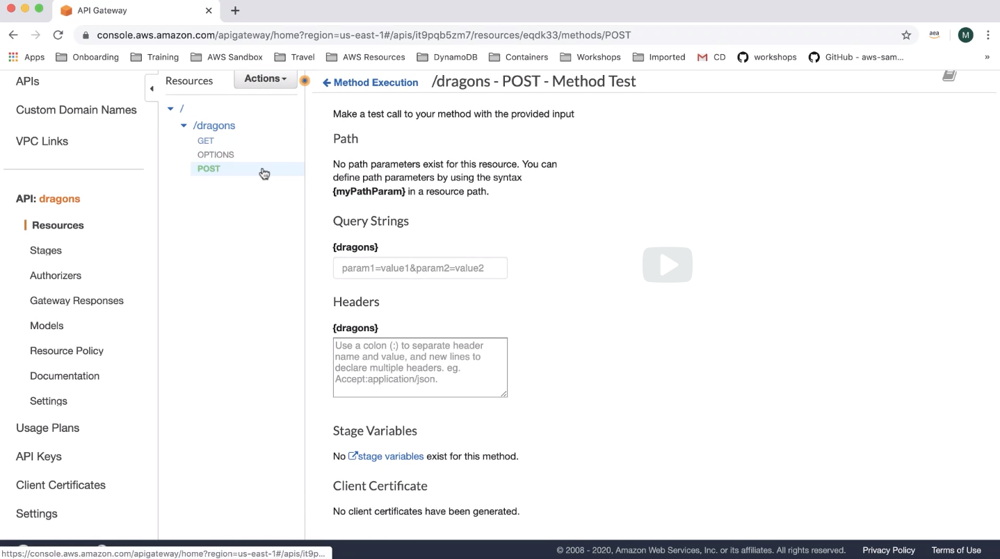
  
and I'm going to try to submit this with nothing. So if I don't include any payload at all, we should be able to see the execution fail since it should not pass validation. So if I go ahead and just click test,  
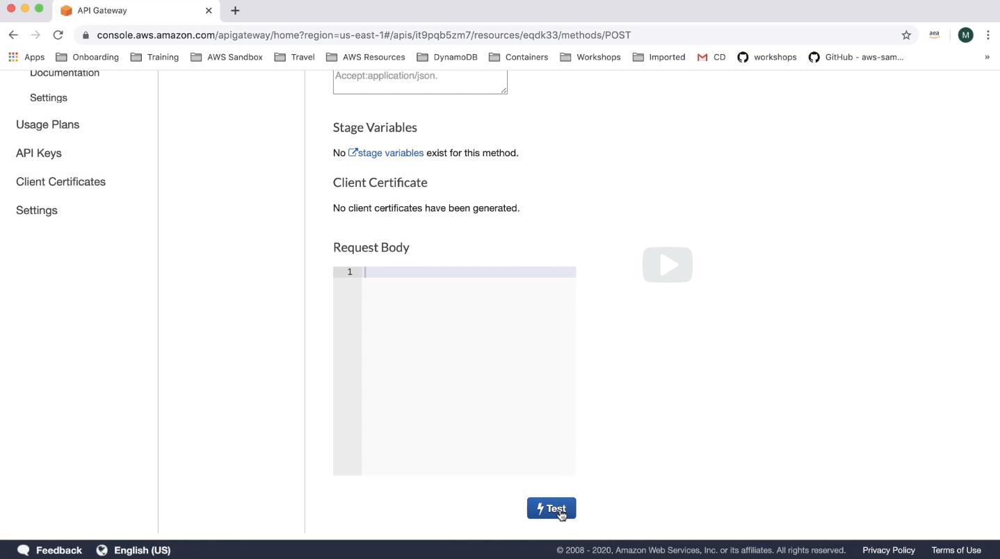
  
let's read the logs.  
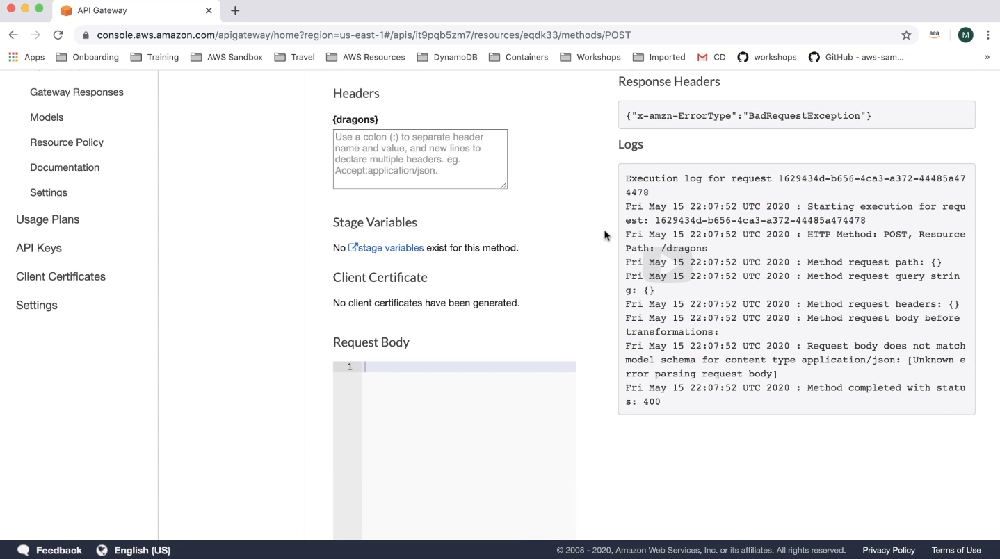
  
We can see it starts in execution. It's for the POST method for the dragon resource. And we can then see that the request does not match model schema for content type application/JSON, unknown error parsing request body. That is what we would expect here
because this is an empty request body where we should be seeing something that should be molded, or it should be able to fit that dragon model. So now let's provide some data that should pass and give it another test.

Okay, so now let's add a valid payload into the request body. This is just a new dragon named Frank, and then there's some dummy data that I added in there. Let's click test.
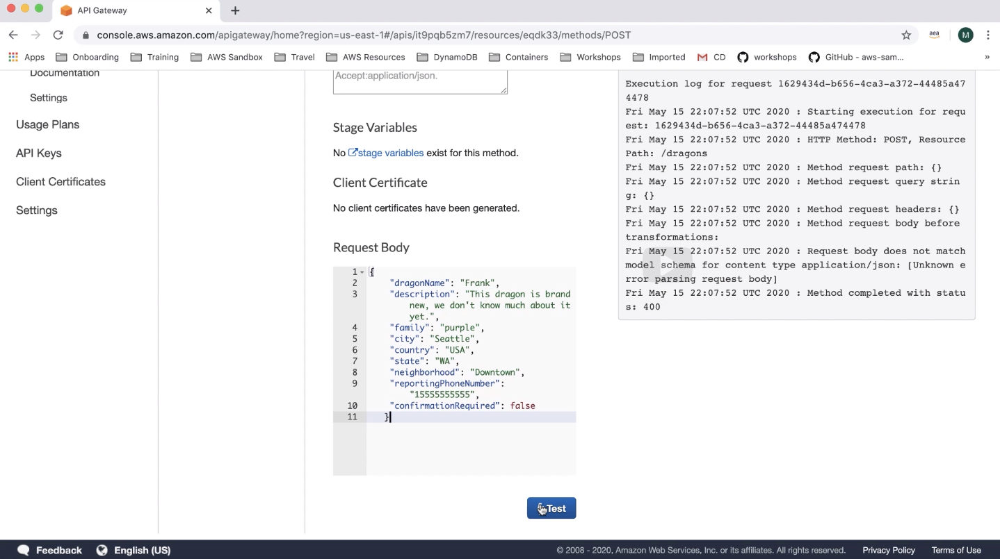
  
And now we can see that we started the execution, that the method request body before transformations, the request validation succeeded because this does fit the model that we just created, and then we can see that it's successfully completed the execution.
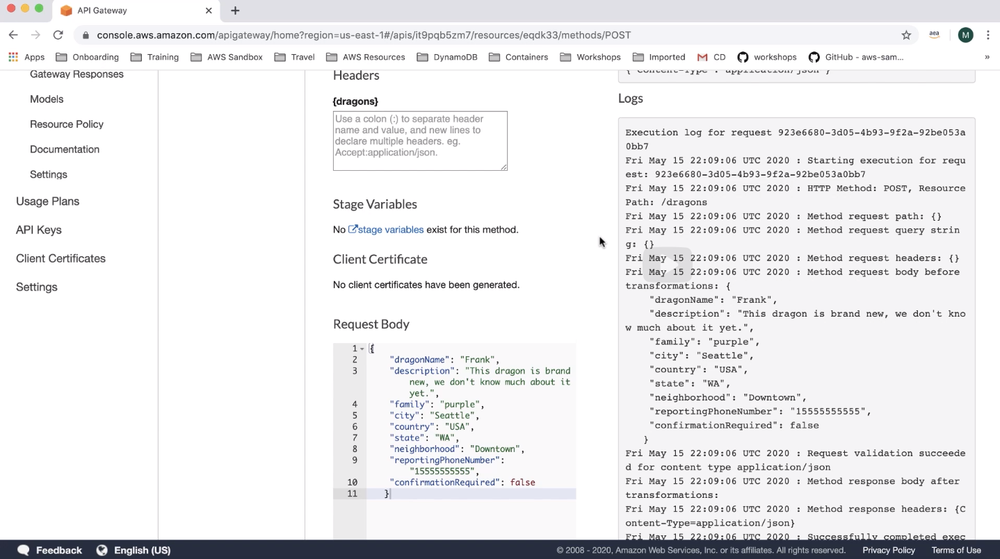
  
Again, this is just a mock endpoint so it's not doing anything yet, but it did at least pass the validation.  
  
All right, so API Gateway is now validating the incoming request against a model and it is responding with the GET method
with those mappings that we already had created.  

That means that this API is totally mocked up. So now we can deploy it and interact with it as if it was our real API.


<pre>


    
</pre>
## Models, Mappings, Request Validation Notes

### <ins>Request Validation</ins>

API Gateway can perform basic validation. This enables you, the API developer, to focus on app-specific deep validation in the backend. You can offload basic validation to API Gateway. For the basic validation, API Gateway verifies either or both of the following conditions:

The required request parameters in the URI, query string, and headers of an incoming request are included and non-blank.

The applicable request payload adheres to the configured JSON schema request model of the method.

Validation is performed in the Method Request and Method Response of the API. You can associate models to validate against at the Method Request or Method Reponse level for each HTTP method. This means that different HTTP methods under a resource can use different models.

Read more about Request Validation at: https://docs.aws.amazon.com/apigateway/latest/developerguide/api-gateway-method-request-validation.html

### <ins>Models</ins>

A model in API Gateway allows you to define a schema for validating requests.

The model is used to define the format of the incoming data on the Method Request, or the format of the outgoing data on the Method Response.

For instructions on how to create a Model click here: https://docs.aws.amazon.com/apigateway/latest/developerguide/how-to-create-model.html

### <ins>Mappings</ins>

Mappings are templates written in Velocity Template Language (VTL) that you can apply to the Integration Request or Integration Response of a REST API. The mapping template allows you to transform data, including injecting hardcoded data, or changing the shape of the data before it passes to the backing service or before sending the response to the client.

You can access information on the payload of the request and other data in your mapping template by using variables. Read about the variables that are available to use in your VTL mappings here: https://docs.aws.amazon.com/apigateway/latest/developerguide/api-gateway-mapping-template-reference.html

### <ins>Stage Variables</ins>

Stage variables are name-value pairs that you can define as configuration attributes associated with a deployment stage of a REST API. They act like environment variables and can be used in your API setup and mapping templates.

With deployment stages in API Gateway, you can manage multiple release stages for each API, such as alpha, beta, and production. Using stage variables you can configure an API deployment stage to interact with different backend endpoints.

You can reference stage variables in Mapping templates through the use of $stageVariables.

Read more about stageVariables here: https://docs.aws.amazon.com/apigateway/latest/developerguide/stage-variables.html

Read more about how to use $stageVariables and other variables and functions you can use in your Mapping templates here: https://docs.aws.amazon.com/apigateway/latest/developerguide/api-gateway-mapping-template-reference.html

<pre>


    
</pre>
## Using Postman to Create Requests

Deploying your API with API Gateway is really easy. So, let's go ahead and take a look at how to do that. As you can see, I'm already logged into the console, and my API is already up, so what I'm going to do is I'm going to click actions, I'm going to click deploy API  
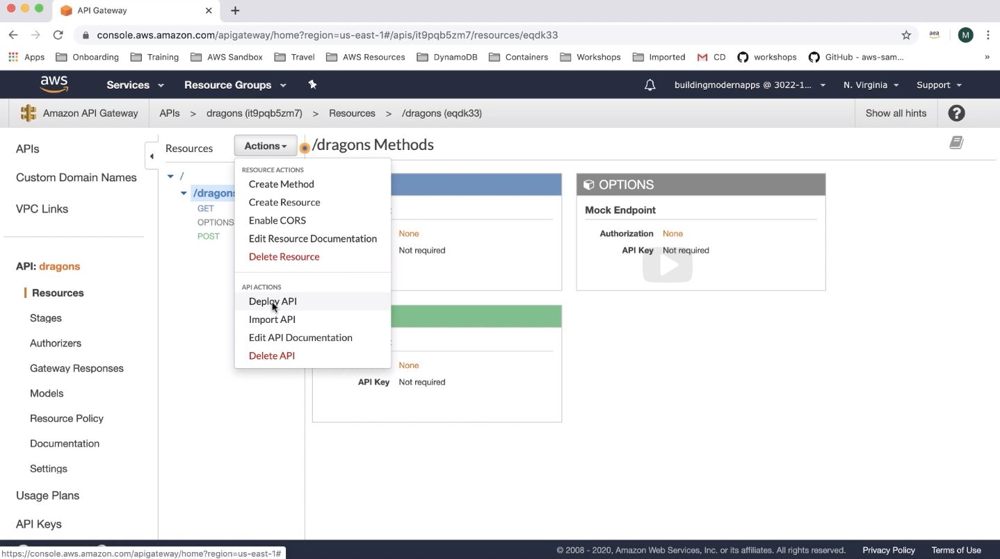
  
and then I'm going to create a new deployment stage, and I'm going to call this one, test, and then I'm going to go ahead and click deploy. 
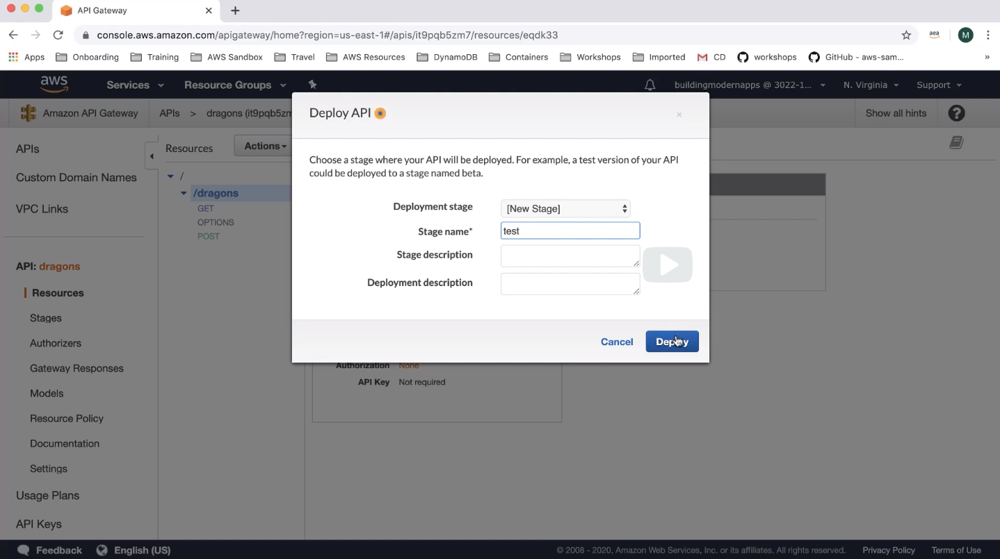
  
You can see how that now gave me an invoke URL up here at the top, this is the endpoint for my API.  
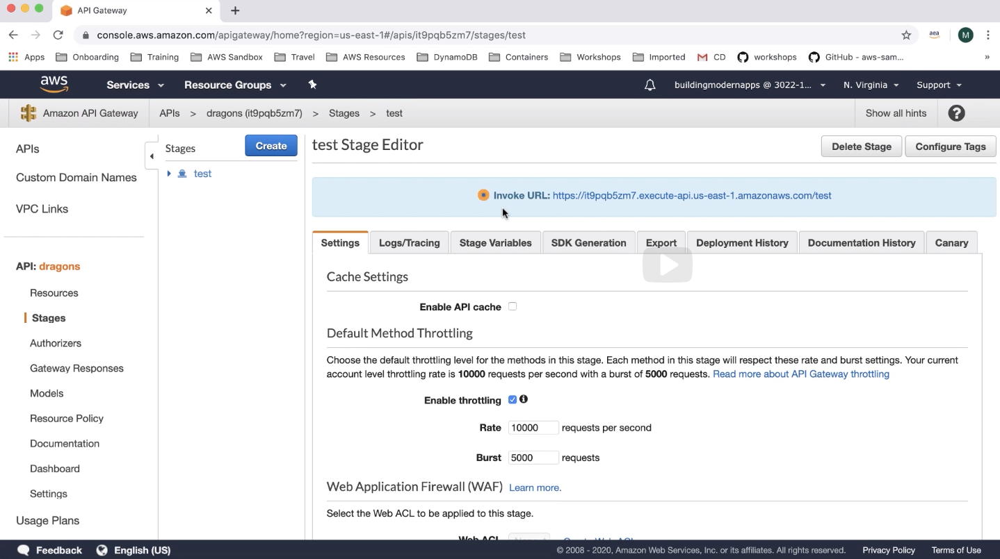
  
Let's go ahead and copy this for later use when we want to go test this out.  
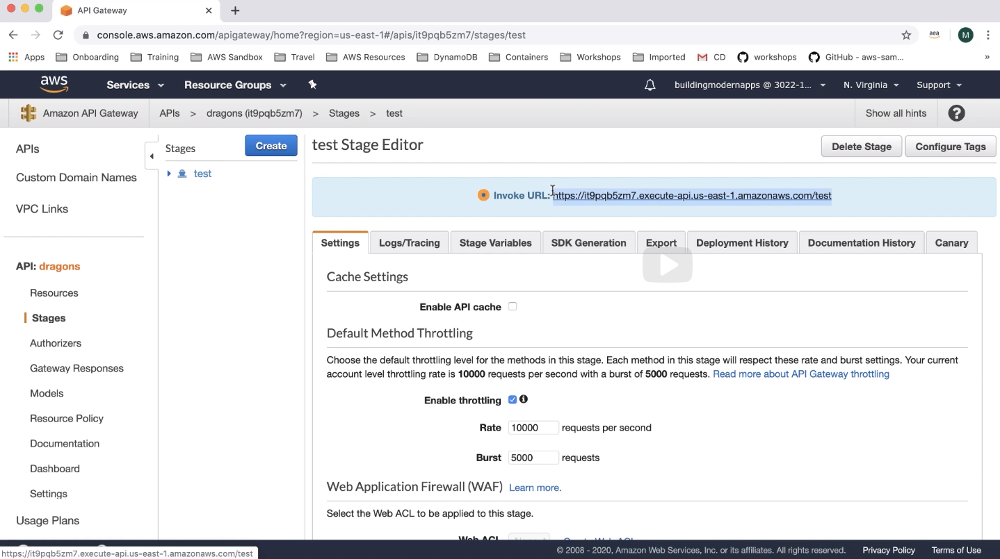
  
You can also see all the other different configurations that you can set at the stage level. This includes things like throttling and caching  
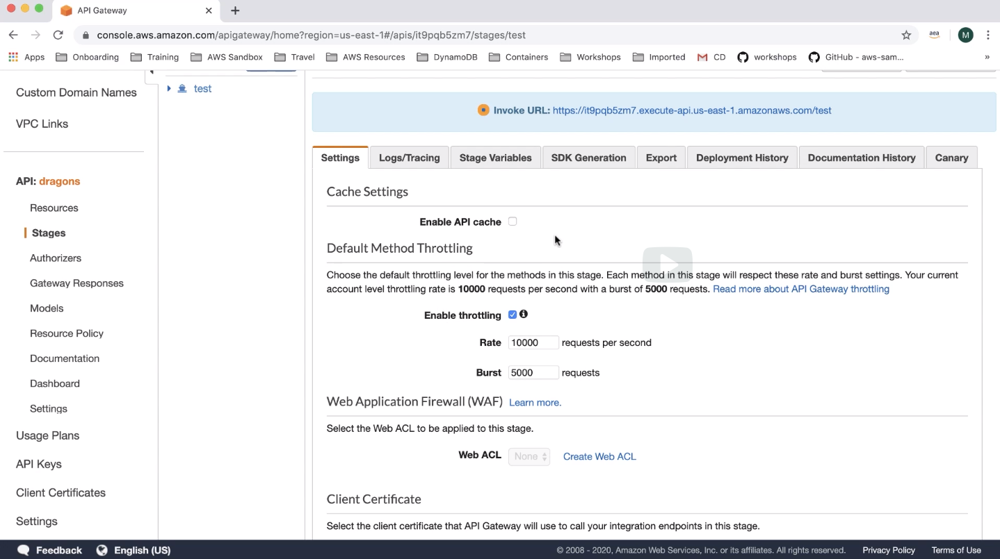
  
as well as logs and tracings
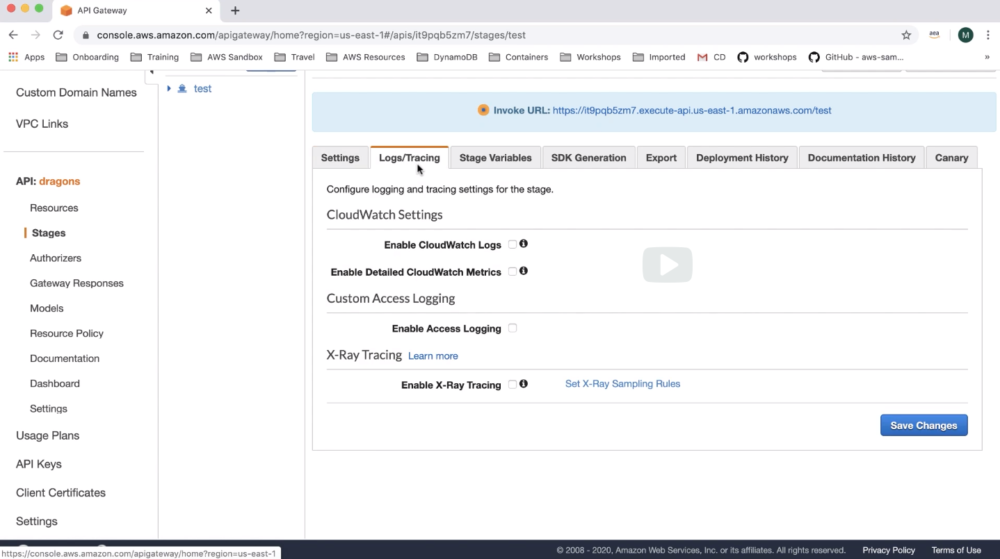
  
and even supporting SDK generation where you can select your platform like Android, JavaScript, iOS, Java or Ruby, this is so that you can generate an SDK from your API, and then you can provide it to clients where they can then write their code.  
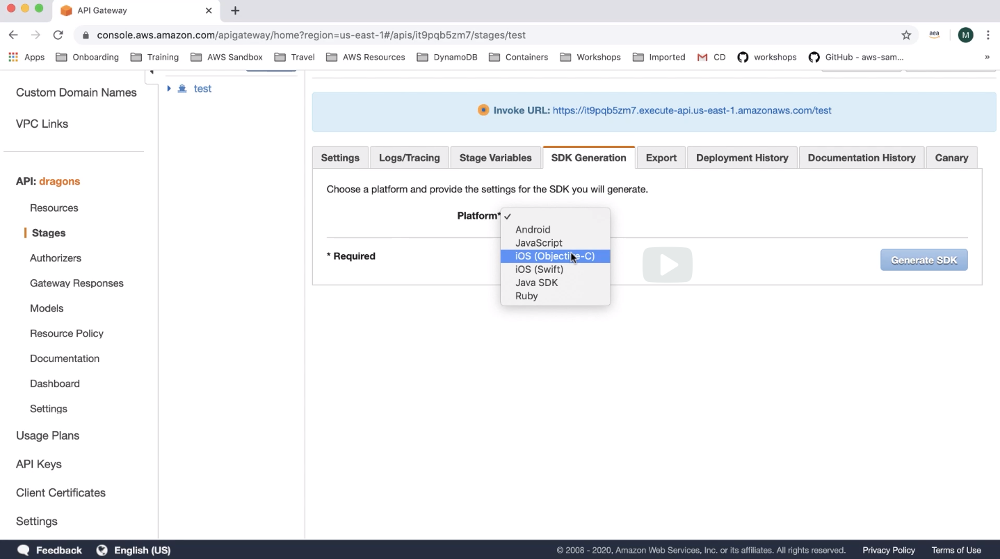
  
So, now what we need to do is we have our API deployed, and we have an active endpoint, what we want to do now is test it out,
I don't want to use the test features built into the console, but instead, I want to actually hit this endpoint from an external entity to ensure that it is functioning as we expect to. Now remember, this is being backed by mocks right now, meaning there is no actual back end yet. So, we're just going to be testing the API functionality at this stage. I'm going to show you how to create a request using a tool called Postman. You could use cURL on the command line just as well if that is more your style. All you need to do is create a request and hit the endpoint that was given to you in the console. But I will just show you another tool that you can use and explore to see if it is right for you. Postman is not an AWS tool, but rather a tool used very widely in the developer community. Postman is a collaboration platform for API development, Postman has features that help support API driven development, but I want to focus on here is their API client. The Postman API client allows you to configure requests, invoke APIs and then view the result. We are going to use the Postman client to invoke the API deployed using API Gateway. This is just to show you how to hit your endpoint using a service that is outside of the AWS environment, proving that your API is deployed and ready to go. Now, we will open up Postman app which I already have open, and then we are going to create a new request by selecting new  
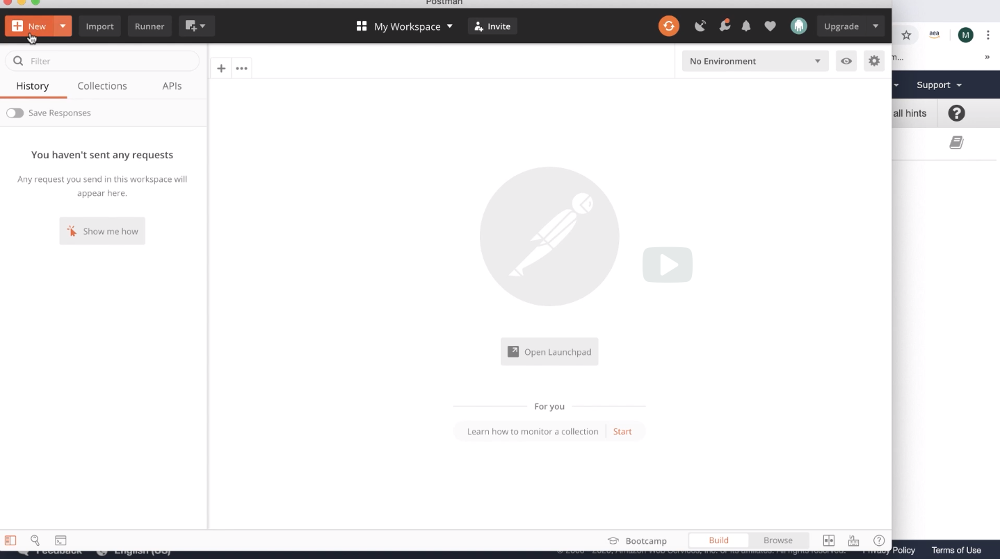
  
and then click requests  
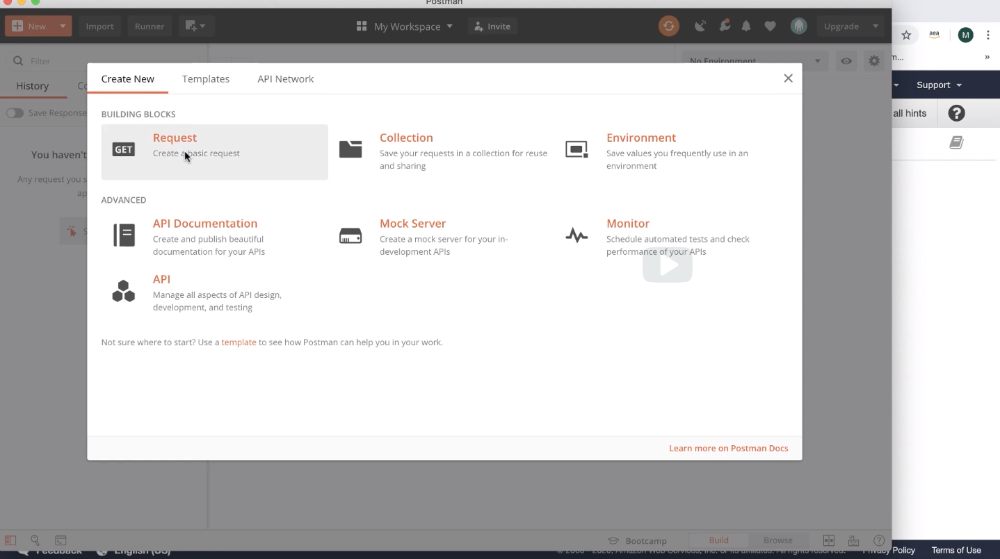
  
I'm going to give this request name `list-dragons`, and then I'm going to save it into an AWS collection, which I already have created in my Postman app, so you can create collections of requests and keep like a history of them.   
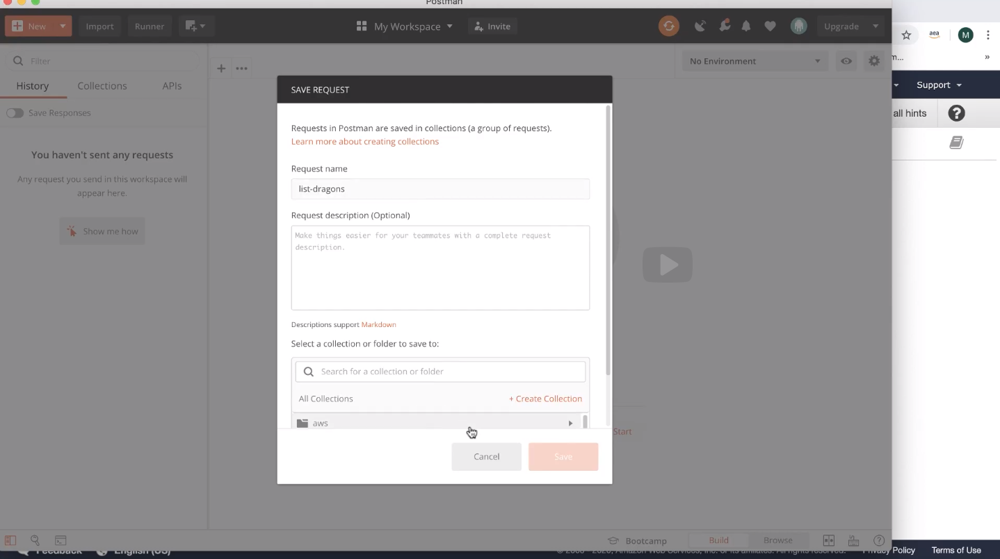
  
So, I'm going to save that to that collection  
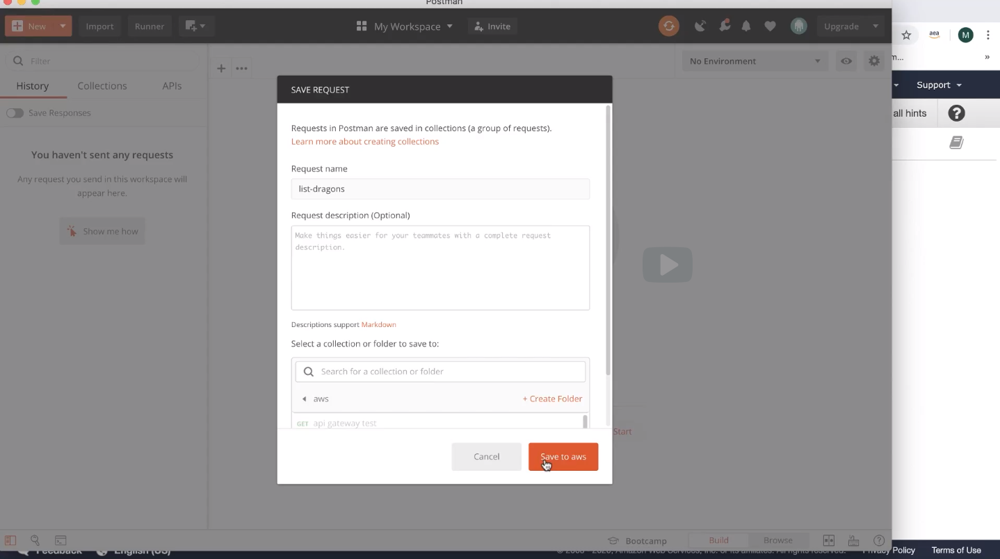
  
and then that opens up this editor here, we're going to paste the URL that was provided for the stage that we deployed our API to, which was this test stage, and then I need to add /dragons in order to hit that specific resource for this API. We're going to leave the request as a GET request and then click send  
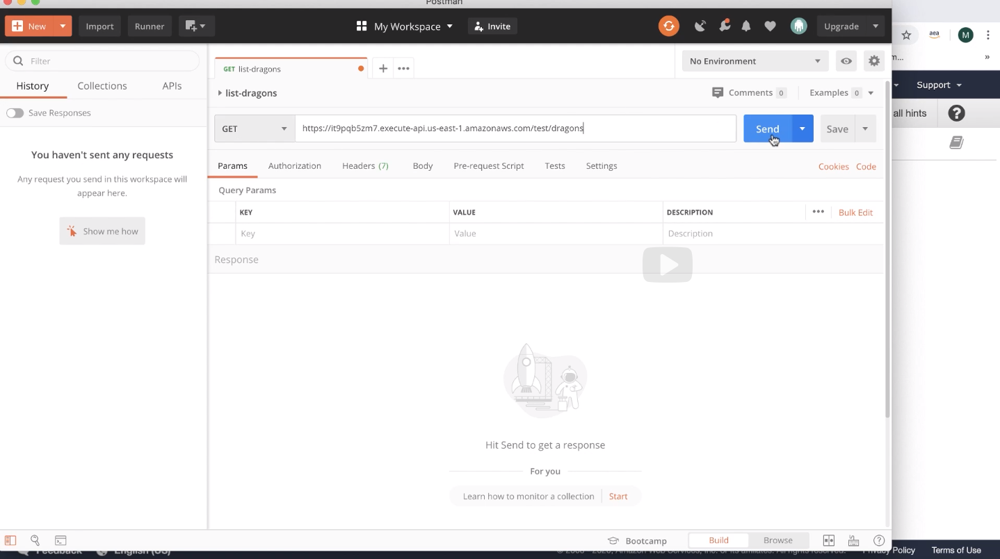
  
and you can see here that it does return the four dragons, so this is our hard coded data, this data is coming from the mapping on that integration response.   
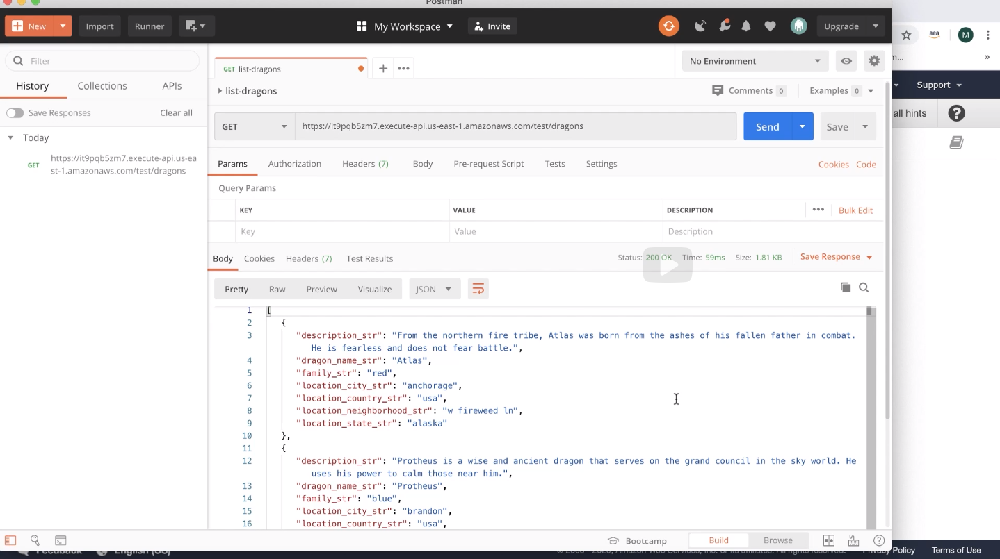
  
So, now let's try the query parameters, so if I do question mark, family = red and click send  
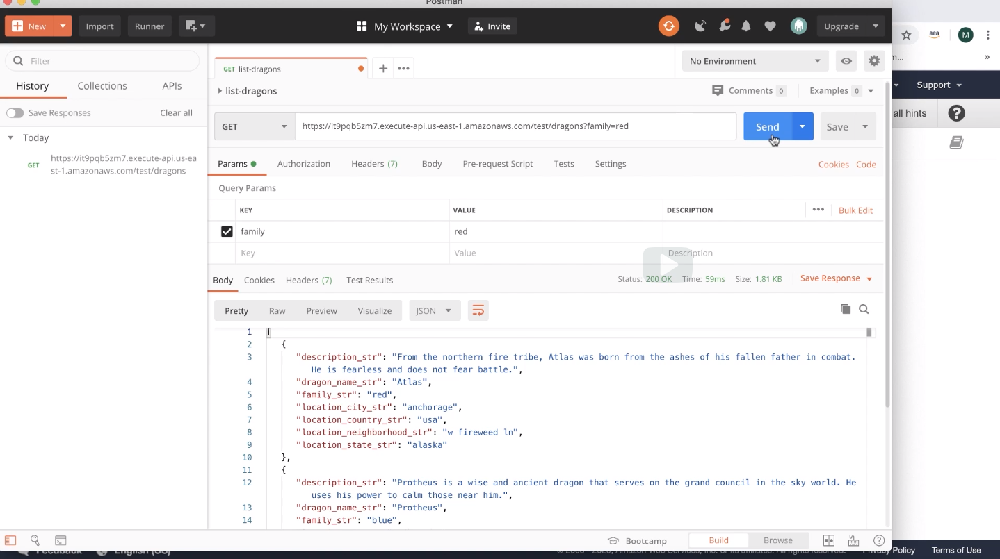
  
you can see now I only have the red dragons  
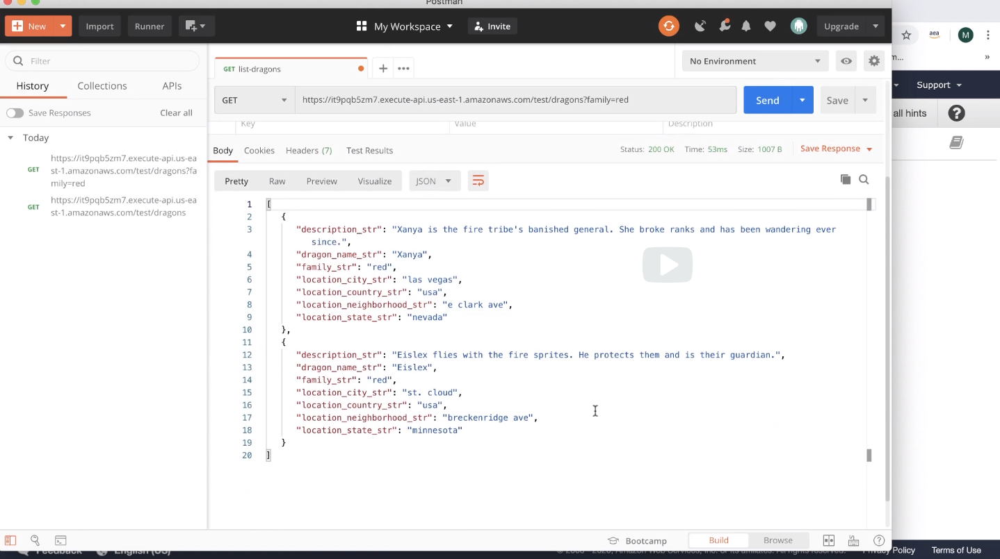
  
lets go ahead and try blue  
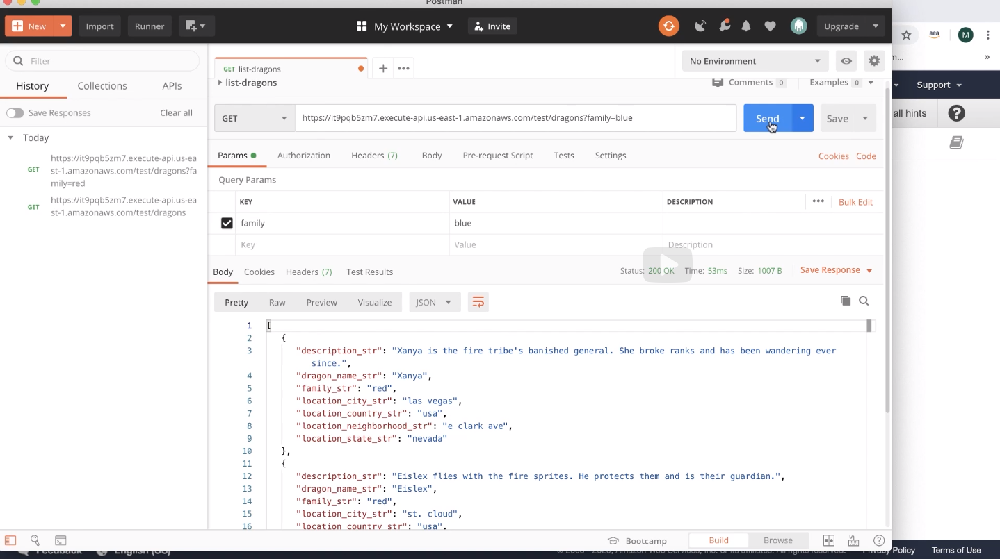
  
send brings back just the blue dragon  
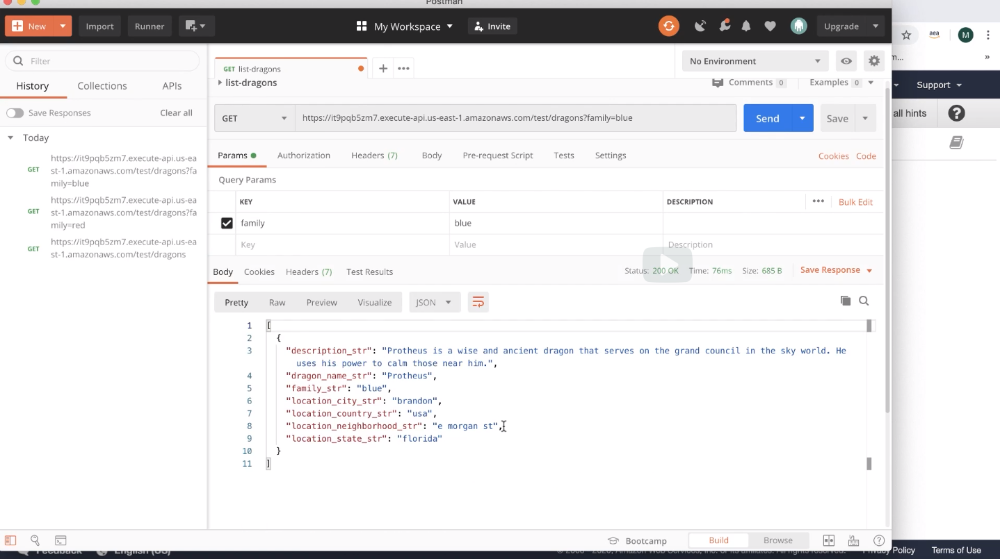
  
and now if I do dragon name = atlas  
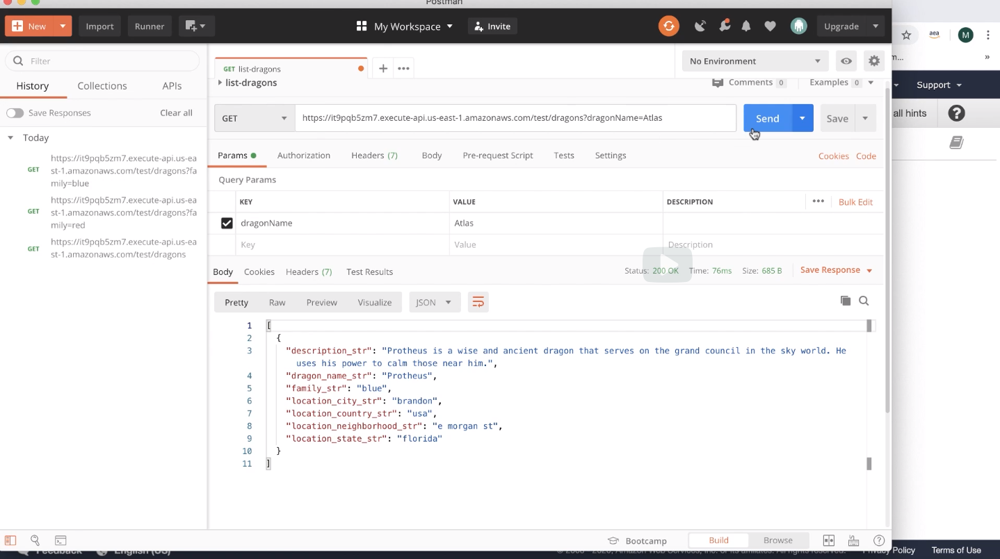
  
brings back just the one  
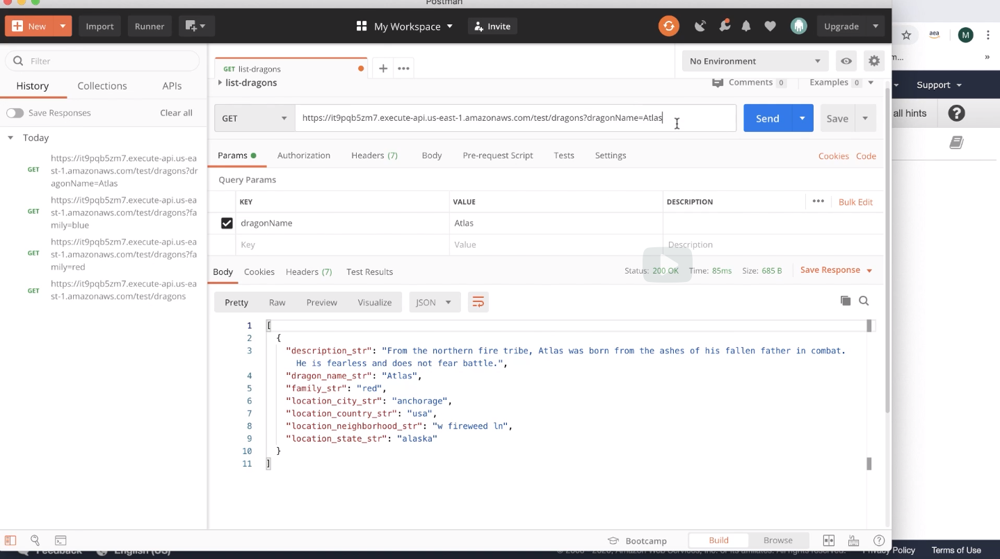
  
and again with no query parameters, it's going to list all dragons. Sorry, so if you actually take off the resource on accident,
like I just did  
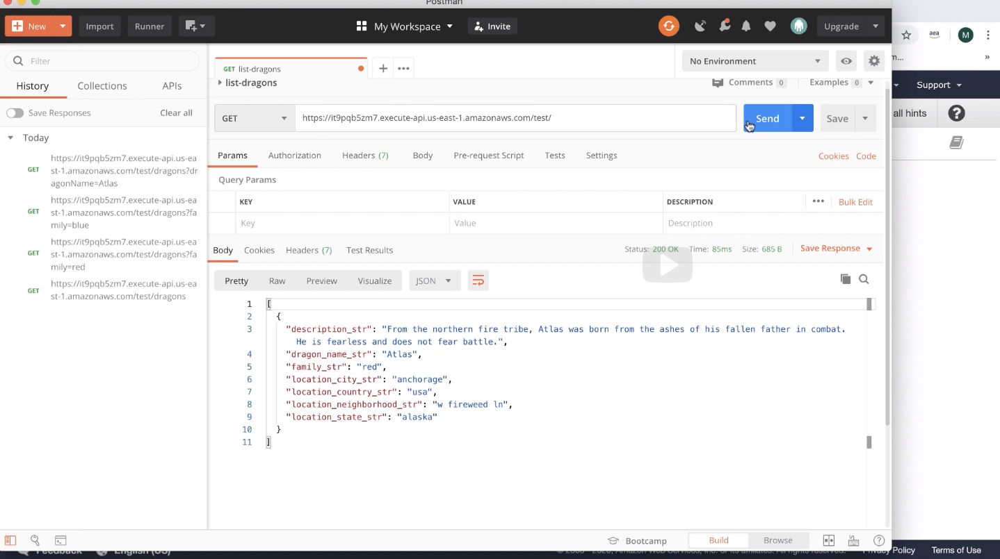
  
you're going to get this missing asset authentication token error  
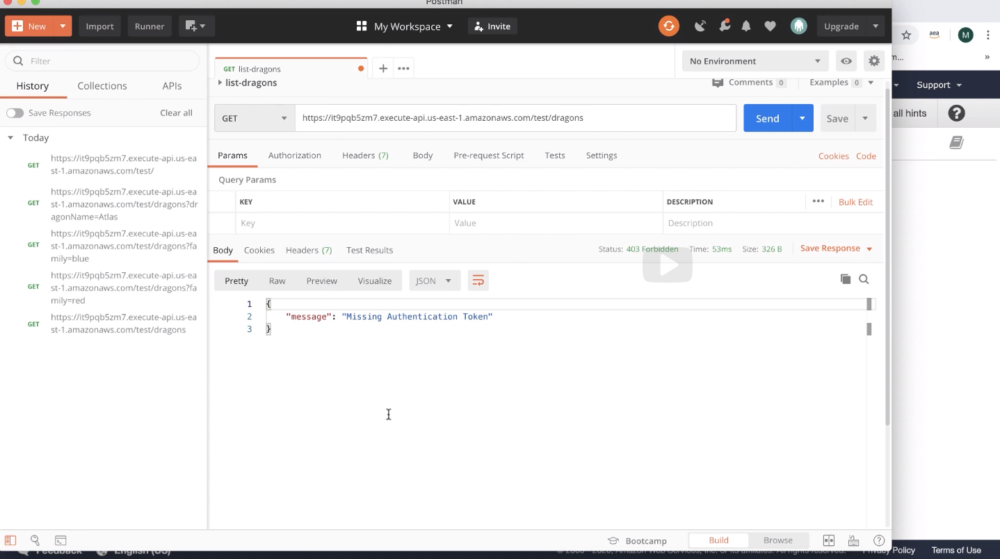
  
you just have to add the dragons resource back on, click send  
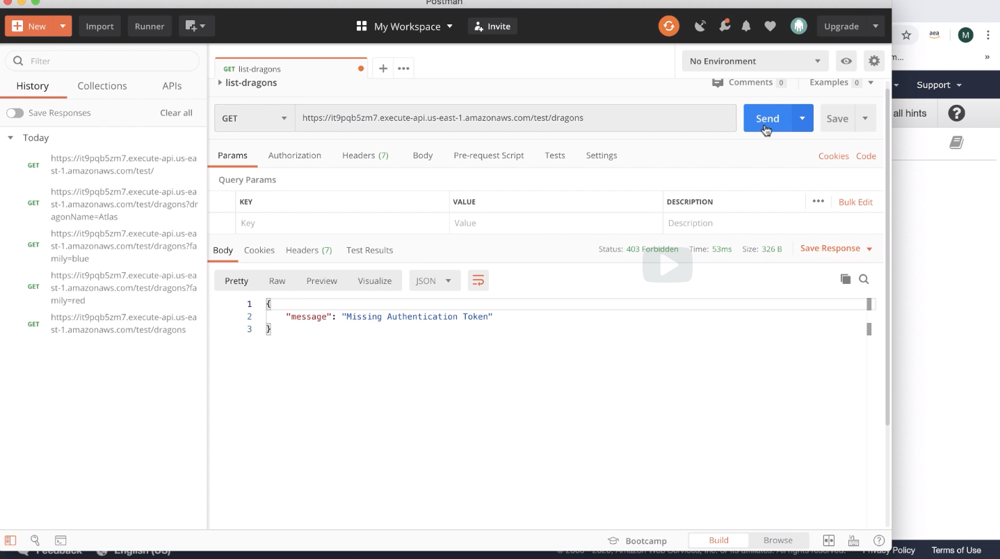
  
there you go and now you have the full data being returned to you again.  
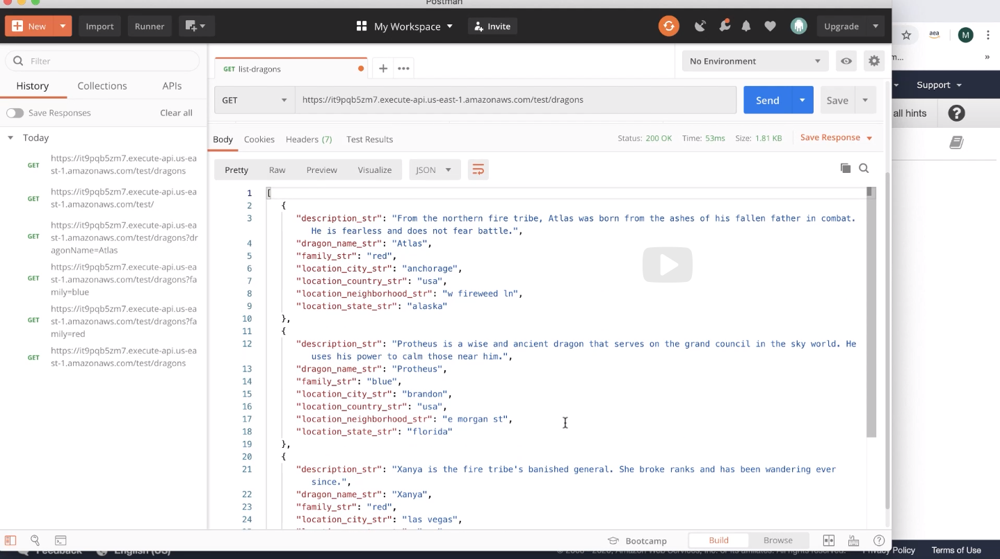
  
Alright, easy enough, now you know how to invoke your API using a tool called Postman. This is just one tool out there that you can use and remember, you can also utilize cURL on the command line as well if you'd like. We will include a link to the Postman documentation and their website for you to explore and maybe download yourself in the class notes.

<pre>


    
</pre>
## API Gateway Stages, deployments, invoking, Postman

### <ins>API Gateway Stages and Deployment</ins>

Once you create a REST API in API Gateway, it doesn’t automatically become available to invoke. You need to publish the API first. In API Gateway, you publish the API to a stage.

A stage is a named reference to a deployment, which is a snapshot of the API. You use a Stage to manage and optimize a particular deployment. For example, you can configure stage settings to enable caching, customize request throttling, configure logging, define stage variables, or attach a canary release for testing.

Every time you make a change to your API, you must deploy it to a stage for that change to go live. You can host multiple versions of your API simultaneously by deploying changes to different stages.

Using stages is perfect for setting up dev, qa, and production environments for you API. You can deploy your API to the appropriate stage as it moves through the software development lifecycle.

Read more about stages at: https://docs.aws.amazon.com/apigateway/latest/developerguide/rest-api-publish.html

### <ins>Invoking your API</ins>

Once an API is published to a stage, an invoke URL is given to the API for that specific stage. Each stage gets it’s own invoke URL. If you are interesting in using custom domains for the invoke url, click here: https://docs.aws.amazon.com/apigateway/latest/developerguide/how-to-custom-domains.html 

### <ins>Postman</ins>

Postman is a collaboration platform for API development. Postman includes features for an API Client, Automated testing, Designing and Mocking APIs, Documentation, and more. Postman is very popular in the software development space, and it’s useful specifically with API development and testing. We focused on the API Client in this course, to download and try out Postman for yourself click here: https://www.postman.com/downloads/